<a href="https://colab.research.google.com/github/wolego2uni/projects/blob/main/Chriscostores_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **UNDERSTAND THE PROBLEM STATEMENT AND BUSINESS CASE**

**CHRIS CO**

Company's requirement 


Chrisco is a British supermarket chain with 40 different stores across The United Kindgom, offering a wide range of products to over 3 million customers annually. 
Transactions Period - 2019-01-01 to 2019-12-31 (One year)

Chrisco is interested in understanding what the data shows. 

The company is most interested in;
* Large and medium sized stores
* Summary of the small stores 
* Any anomalies identified in the data
* Correlations
* Seasonal behaviour
* Outliers
* Suggestion about how the data might be best segmented
* Stores opened and those closed during the year


# **Import libraries** 


In [ ]:
pip install hvplot

     |████████████████████████████████| 3.1MB 4.6MB/s 
     |████████████████████████████████| 1.6MB 38.9MB/s 


In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
import hvplot.pandas 
import holoviews as hv
from bokeh.models import HTMLBox
pd.plotting.register_matplotlib_converters()


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm



# **Importing Chris co's data** 

In [ ]:
customers = pd.read_csv('https://tinyurl.com/ChrisCoDV/001140837/DailyCustomers.csv', index_col=0)
customers.index = pd.to_datetime(customers.index) # convert index to date time 
marketing = pd.read_csv('https://tinyurl.com/ChrisCoDV/001140837/StoreMarketing.csv',index_col=0)
overhead = pd.read_csv('https://tinyurl.com/ChrisCoDV/001140837/StoreOverheads.csv', index_col=0)
storesize = pd.read_csv('https://tinyurl.com/ChrisCoDV/001140837/StoreSize.csv', index_col=0)
staff = pd.read_csv('https://tinyurl.com/ChrisCoDV/001140837/StoreStaff.csv', index_col=0)

In [ ]:
summary_data = pd.DataFrame(index=customers.columns) #Generating the summary dataframe for Chrisco
summary_data['Customers']= customers.sum()
summary_data['Store_size'] = storesize.values
summary_data['Staff'] = staff.values
summary_data['Marketing'] = marketing.values
summary_data['Overhead'] = overhead.values

# **Exploratory Data Anaylsis(EDA) of Chris Co** 

In [ ]:
summary_data.describe().round(3)
#rounding the decimal to 3 digits

,Customers,Store_size,Staff,Marketing,Overhead
count,40.000,40.00,40.000,40.000,40.000
mean,79599.625,1294.85,9.300,8450.000,53350.000
std,100590.149,1993.46,14.283,10357.581,29616.826
min,3983.000,31.00,1.000,1000.000,11000.000
25%,22205.000,218.00,2.000,3000.000,25250.000
50%,27452.000,419.50,4.000,3000.000,53500.000
75%,133278.500,1532.25,6.750,15000.000,82000.000
max,353292.000,7441.00,61.000,40000.000,100000.000


In [ ]:
#Viewing the summary data
summary_data.head()


,Customers,Store_size,Staff,Marketing,Overhead
RGS,179589,1851,9,18000,52000
NAQ,152253,1426,6,18000,19000
BTB,27702,424,3,4000,44000
MUY,125653,2252,17,15000,82000
EFN,32629,209,2,4000,66000


In [ ]:
summary_data['Customers'].sum()
#Total number of customers across all of ChrisCo stores in the year 2019

3183985

In [ ]:
customers.head(10)

,RGS,NAQ,BTB,MUY,EFN,CNQ,UGJ,ZSD,TAP,NGB,MAJ,XML,PGL,CFG,WYG,SGA,DZT,PAA,VSM,QSN,XSV,OSG,ZMS,WGR,YGY,VYZ,AEI,ATT,ENY,WMB,YYO,DTJ,SMM,UMU,NMO,QMD,OMV,BZM,TSE,RAH
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-01-01,515,432,74,288,100,62,76,0,64,0,0,75,412,74,72,1027,70,408,67,1080,71,405,63,60,84,68,0,59,98,112,0,76,1026,80,0,447,414,82,84,1124
2019-01-02,614,389,77,355,88,74,81,0,103,0,0,69,452,75,101,970,52,497,69,740,86,493,70,55,77,83,0,57,73,105,0,59,985,69,0,511,429,63,86,980
2019-01-03,369,466,82,304,85,59,67,0,85,0,0,81,361,70,86,1109,62,357,59,683,60,429,42,63,76,73,0,54,78,101,0,62,885,71,0,464,327,57,92,937
2019-01-04,384,401,67,318,95,65,69,0,76,0,0,66,299,69,87,970,72,456,68,691,98,339,52,52,81,58,0,58,106,97,0,67,829,64,0,450,371,77,87,879
2019-01-05,408,265,78,281,90,61,68,0,70,0,0,69,363,79,96,792,57,373,75,610,87,332,68,65,82,61,0,52,116,81,0,72,829,55,0,393,287,71,92,932
2019-01-06,473,426,81,377,102,60,78,0,86,0,0,70,404,62,88,881,80,463,66,643,87,455,42,60,83,59,0,61,83,62,0,73,887,69,0,379,322,73,91,1079
2019-01-07,502,463,69,365,86,69,56,0,59,0,0,79,363,69,70,1082,69,473,71,810,93,404,52,63,87,55,0,56,98,111,0,64,979,84,0,452,403,81,84,958
2019-01-08,580,435,77,309,86,65,92,0,83,0,0,58,338,77,91,1196,52,536,59,813,91,386,47,55,81,63,0,63,85,86,0,62,1014,58,0,556,395,68,84,1157
2019-01-09,621,511,81,379,76,61,64,0,85,0,0,74,363,72,78,1166,64,478,71,706,115,496,61,57,76,37,0,58,100,108,0,67,975,73,0,403,462,82,98,933


In [ ]:
customers.columns

Index(['RGS', 'NAQ', 'BTB', 'MUY', 'EFN', 'CNQ', 'UGJ', 'ZSD', 'TAP', 'NGB',
       'MAJ', 'XML', 'PGL', 'CFG', 'WYG', 'SGA', 'DZT', 'PAA', 'VSM', 'QSN',
       'XSV', 'OSG', 'ZMS', 'WGR', 'YGY', 'VYZ', 'AEI', 'ATT', 'ENY', 'WMB',
       'YYO', 'DTJ', 'SMM', 'UMU', 'NMO', 'QMD', 'OMV', 'BZM', 'TSE', 'RAH'],
      dtype='object')

In [ ]:
customers.info()  #There are no missing values across the 40 stores

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 365 entries, 2019-01-01 to 2019-12-31
Data columns (total 40 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   RGS     365 non-null    int64
 1   NAQ     365 non-null    int64
 2   BTB     365 non-null    int64
 3   MUY     365 non-null    int64
 4   EFN     365 non-null    int64
 5   CNQ     365 non-null    int64
 6   UGJ     365 non-null    int64
 7   ZSD     365 non-null    int64
 8   TAP     365 non-null    int64
 9   NGB     365 non-null    int64
 10  MAJ     365 non-null    int64
 11  XML     365 non-null    int64
 12  PGL     365 non-null    int64
 13  CFG     365 non-null    int64
 14  WYG     365 non-null    int64
 15  SGA     365 non-null    int64
 16  DZT     365 non-null    int64
 17  PAA     365 non-null    int64
 18  VSM     365 non-null    int64
 19  QSN     365 non-null    int64
 20  XSV     365 non-null    int64
 21  OSG     365 non-null    int64
 22  ZMS     365 non-null    int64
 

In [ ]:
customers_reorder = customers.reindex(customers.sum().sort_values(ascending=False).index, axis=1) 
#ordering the stores by descending order of customers count. 
customers_reorder.sum()

RAH    353292
SMM    336765
SGA    330402
QSN    306734
RGS    179589
PAA    177802
QMD    165896
NAQ    152253
OSG    151802
PGL    141518
OMV    130532
MUY    125653
WMB     33032
EFN     32629
ENY     32139
TSE     32122
WYG     31408
TAP     29460
YGY     28980
BTB     27702
UGJ     27202
BZM     26843
XML     26281
CFG     25734
VYZ     24875
VSM     24849
UMU     24534
CNQ     24093
DTJ     24025
DZT     22491
ATT     21347
WGR     20982
NMO     18415
AEI     17276
XSV     15612
ZMS     10590
NGB      9582
YYO      8673
MAJ      6888
ZSD      3983
dtype: int64

In [ ]:
#Investigating the time series 
ct = customers.T.sum()
ct

Date
2019-01-01    9249
2019-01-02    9087
2019-01-03    8256
2019-01-04    8018
2019-01-05    7510
              ... 
2019-12-27    8502
2019-12-28    8170
2019-12-29    8416
2019-12-30    9783
2019-12-31    9848
Length: 365, dtype: int64

In [ ]:
#Sorting the dates by date with the highest volume of customers
ct.sort_values(ascending=False)

Date
2019-12-17    10735
2019-07-23    10578
2019-06-04    10330
2019-12-11    10218
2019-11-13    10104
              ...  
2019-02-22     7416
2019-03-30     7415
2019-09-13     7407
2019-08-23     7373
2019-03-23     7333
Length: 365, dtype: int64

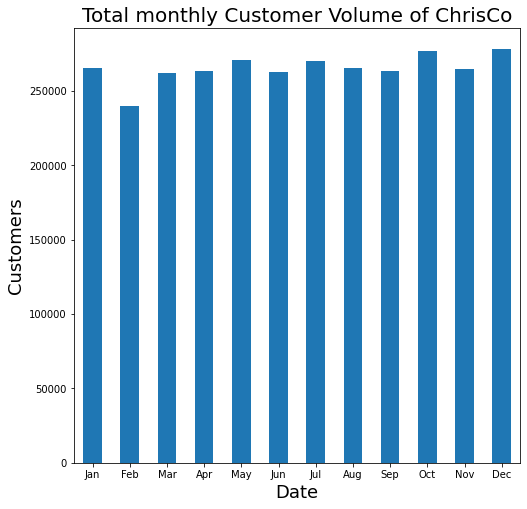

In [ ]:
sample_rate = 'M'  # Monthly
ct_m= ct.resample(sample_rate).sum()
plt.figure(figsize=[8,8])
ct_m.plot(kind= 'bar')
degrees = 0
plt.xticks([0,1,2,3,4,5,6,7,8,9,10, 11], ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"], rotation= degrees)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Total monthly Customer Volume of ChrisCo', fontsize=20)
plt.show()

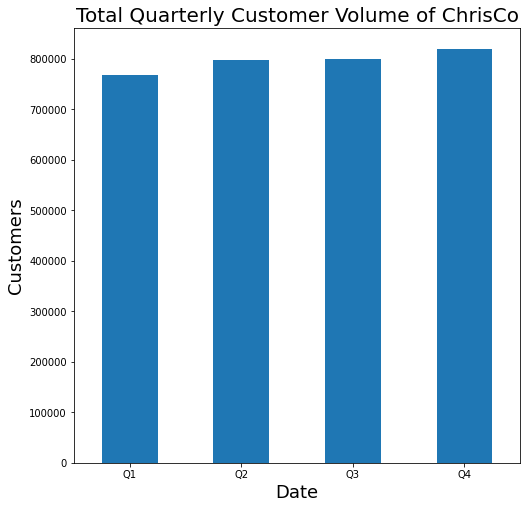

In [ ]:
sample_rate = 'Q'  # Quarterly
ct_Q= ct.resample(sample_rate).sum()
plt.figure(figsize=[8,8])
ct_Q.plot(kind= 'bar')
degrees = 0
plt.xticks([0,1,2,3], ["Q1", "Q2", "Q3", "Q4"], rotation = degrees)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Total Quarterly Customer Volume of ChrisCo', fontsize=20)
plt.show()

#**Preliminary EDA results**
1. Chrisco recorded its lowest total daily customer visit on 23/03/2019, with 7,333 across its stores.

2. Chrisco recorded its highest number of customers registered on 17/12/2019 across all its stores, with 10,735 customers.

3. The stores with the highest customers are WMB, EFN, ENY, TSE, with over 300,0000 customers each during the year - all others had less than 300,000 customers.


4. The stores with the lowest number of customers are ZMS, NGB, YYO, MAJ and ZSD, with less than 15,000 customers. ZSD distinctively has the lowest number of customers, with 3983 customers visiting all year round.

5. There is a slight marginal growth in the number of customers from Q1 to Q4.

#Data filtering 


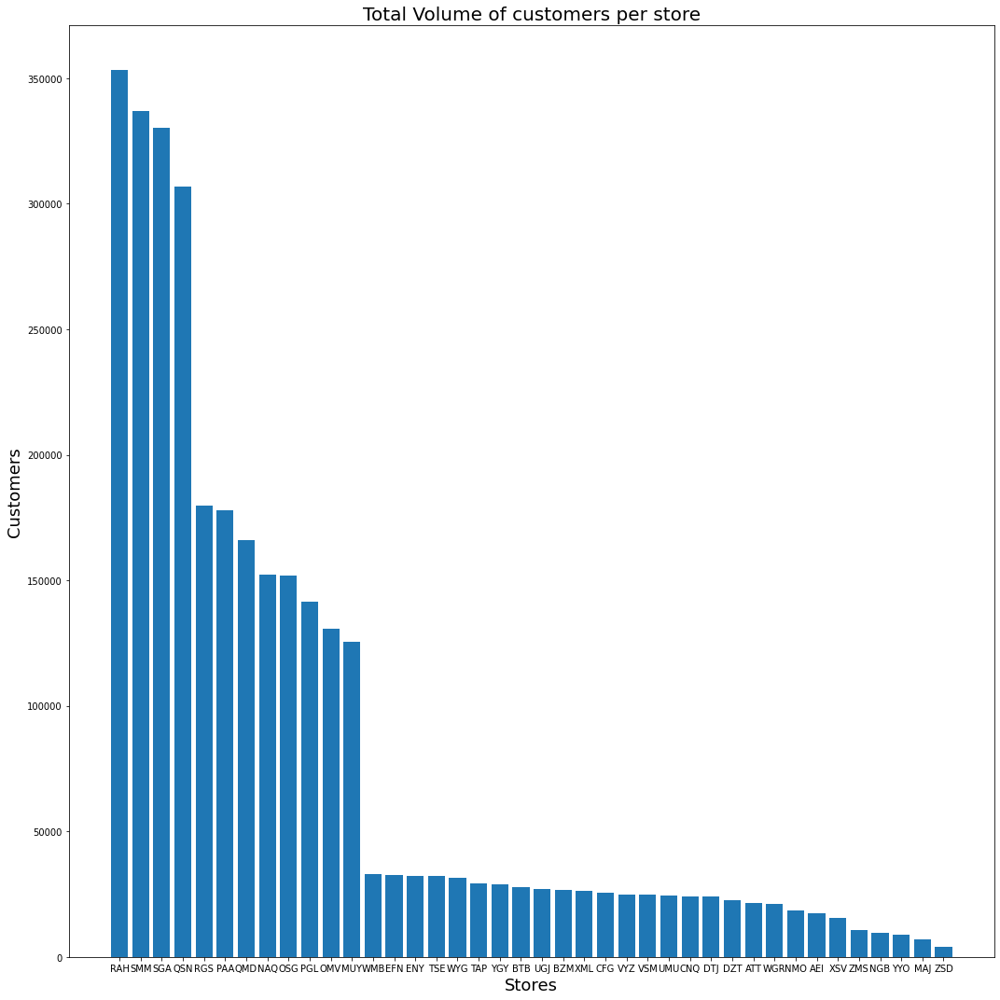

In [ ]:
#Plot showing total customers per store
plt.figure(figsize=(15, 15))
x_pos = np.arange(len(customers_reorder.columns))
plt.bar(x_pos, customers_reorder.sum(), align='center')
plt.xticks(x_pos, customers_reorder.columns)
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Total Volume of customers per store', fontsize=20)
plt.tight_layout()
plt.show()

There is a significant gap in customer volume; firstly, we have the top 4 stores with a customers base of above 300,000 each. 

Next, we have another distinct group of 8 medium-sized stores with customers over 100,000 each, after which we have a final group of the low and very low volume of customer stores, each with a customer volume of fewer than 50,000 customers each. 

Store RAH is a High volume Store
Store SMM is a High volume Store
Store SGA is a High volume Store
Store QSN is a High volume Store
Store RGS is a Medium volume Store
Store PAA is a Medium volume Store
Store QMD is a Medium volume Store
Store NAQ is a Medium volume Store
Store OSG is a Medium volume Store
Store PGL is a Medium volume Store
Store OMV is a Medium volume Store
Store MUY is a Medium volume Store
Store WMB is a Low volume Store
Store EFN is a Low volume Store
Store ENY is a Low volume Store
Store TSE is a Low volume Store
Store WYG is a Low volume Store
Store TAP is a Low volume Store
Store YGY is a Low volume Store
Store BTB is a Low volume Store
Store UGJ is a Low volume Store
Store BZM is a Low volume Store
Store XML is a Low volume Store
Store CFG is a Low volume Store
Store VYZ is a Very Low volume Store
Store VSM is a Very Low volume Store
Store UMU is a Very Low volume Store
Store CNQ is a Very Low volume Store
Store DTJ is a Very Low volume Store
Store DZT is a Very

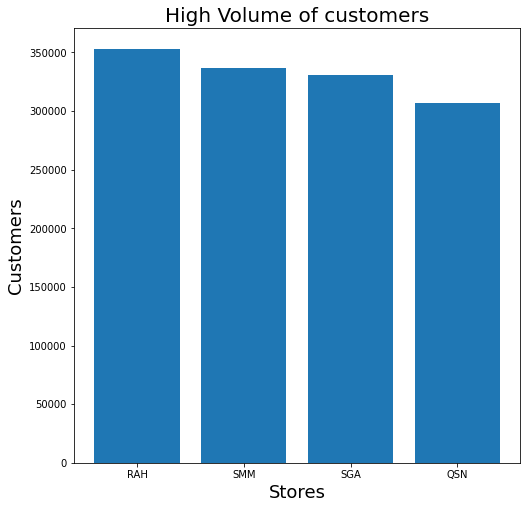

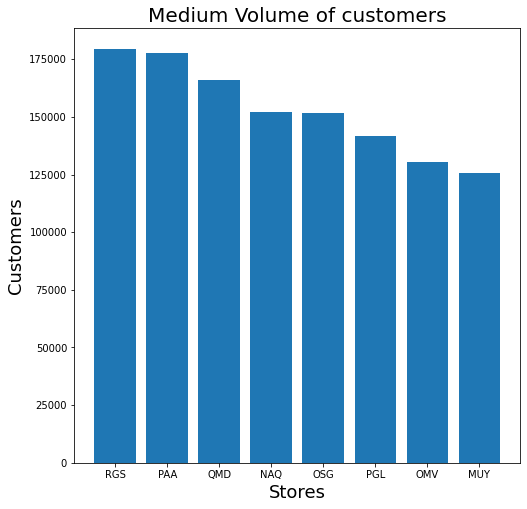

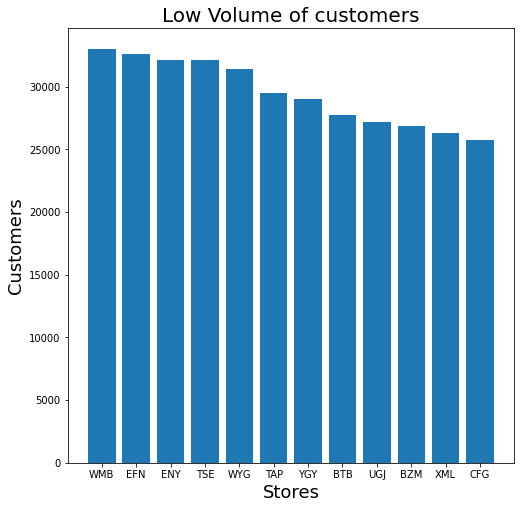

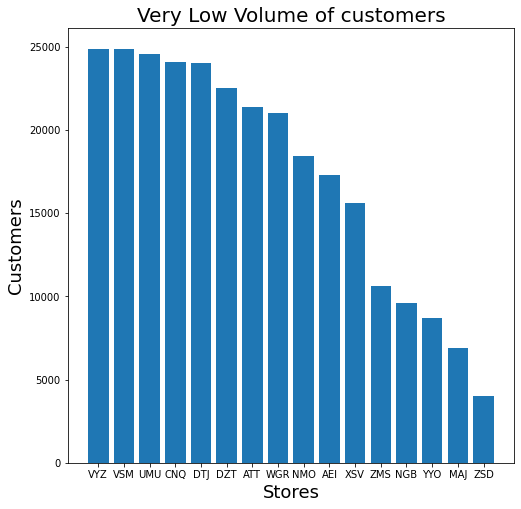

In [ ]:
#Data filtering by value for automatic catergorization of customers
categories = ['High', 'Medium', 'Low', 'Very Low']
categories_selected = [[] for i in range(len(categories))]
for name in customers_reorder.columns:
    total_customers = customers_reorder[name].sum()
    if total_customers > 300000:
        category = 0
    elif total_customers > 100000:
        category = 1
    elif total_customers > 25000:
        category = 2
    else:
        category = 3
    categories_selected[category].append(name)
    print('Store ' + name + ' is a ' + categories[category] + ' volume Store')

for i in range(len(categories)):
    print(categories[i] + ': ' + str(categories_selected[i]))

for i, selected in enumerate(categories_selected):
    plt.figure(figsize=(8, 8))
    x_pos = np.arange(len(customers_reorder[selected].columns))
    plt.bar(x_pos, customers_reorder[selected].sum(), align='center')
    plt.xticks(x_pos, customers_reorder[selected].columns)
    plt.xlabel('Stores', fontsize=18)
    plt.ylabel('Customers', fontsize=18)
    plt.title(categories[i] + ' Volume of customers', fontsize=20)
    plt.show()

**Segementing the stores**

1. High Volume Stores - RAH, SMM, SGA and QSN (300,000 customers and above each)

2. Medium customer stores - RGS, PAA, QMD, NAQ, OSG, PGL, OMV and MUY (100,000 customers and above each)

3. Low customer stores  - WMB, EFN, ENY, TSE, WYG, TAP, YGY, BTB, UGJ, BZM,'XML,CFG (25,000 customers and above each)

4. Very Low customer stores - VYZ, VSM, UMU, CNQ, DTJ, DZT, ATT, WGR, NMO, AEI,XSV, ZMS, NGB, YYO, MAJ and ZSD
(25,000 customers  or below for each of the stores)


Data segmentation by values

In [ ]:
#Creating segements based on value, these segements will be used for further investigating the data given
selected = customers_reorder.columns[customers_reorder.sum() > 300000]
customers_selected1 = customers_reorder[selected]
print(customers_selected1.head())




             RAH   SMM   SGA   QSN
Date                              
2019-01-01  1124  1026  1027  1080
2019-01-02   980   985   970   740
2019-01-03   937   885  1109   683
2019-01-04   879   829   970   691
2019-01-05   932   829   792   610


In [ ]:
customers_selected1.columns

Index(['RAH', 'SMM', 'SGA', 'QSN'], dtype='object')

<Figure size 576x576 with 0 Axes>

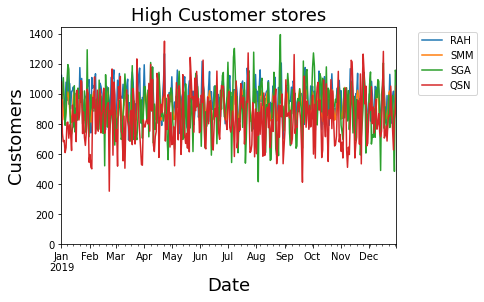

In [ ]:
plt.figure(figsize=[8,8])
customers_selected1.plot.line()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left') #Places the legend outside the plot
plt.ylim(0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High Customer stores', fontsize= 18)
plt.show()

The high customer stores are closely packed with store QSN the noisest. 

In [ ]:
selected = customers_reorder.columns[(customers_reorder.sum() > 100000) & (customers_reorder.sum() < 300000)]
customers_selected2 = customers_reorder[selected]
print(customers_selected2.head())

            RGS  PAA  QMD  NAQ  OSG  PGL  OMV  MUY
Date                                              
2019-01-01  515  408  447  432  405  412  414  288
2019-01-02  614  497  511  389  493  452  429  355
2019-01-03  369  357  464  466  429  361  327  304
2019-01-04  384  456  450  401  339  299  371  318
2019-01-05  408  373  393  265  332  363  287  281


In [ ]:
customers_selected2.columns

Index(['RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY'], dtype='object')

<Figure size 576x576 with 0 Axes>

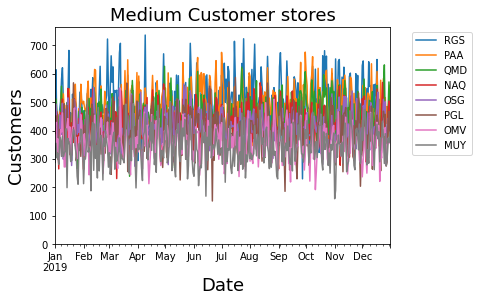

In [ ]:
plt.figure(figsize=[8,8])
customers_selected2.plot.line()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left') #Places the legend outside the plot
plt.ylim(0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Medium Customer stores', fontsize= 18)
plt.show()

The data is closely packed and requires further investigation

In [ ]:
selected = customers_reorder.columns[(customers_reorder.sum() > 25000) & (customers_reorder.sum() < 100000)]
customers_selected3 = customers_reorder[selected]
print(customers_selected3.head())

            WMB  EFN  ENY  TSE  WYG  TAP  YGY  BTB  UGJ  BZM  XML  CFG
Date                                                                  
2019-01-01  112  100   98   84   72   64   84   74   76   82   75   74
2019-01-02  105   88   73   86  101  103   77   77   81   63   69   75
2019-01-03  101   85   78   92   86   85   76   82   67   57   81   70
2019-01-04   97   95  106   87   87   76   81   67   69   77   66   69
2019-01-05   81   90  116   92   96   70   82   78   68   71   69   79


<Figure size 576x576 with 0 Axes>

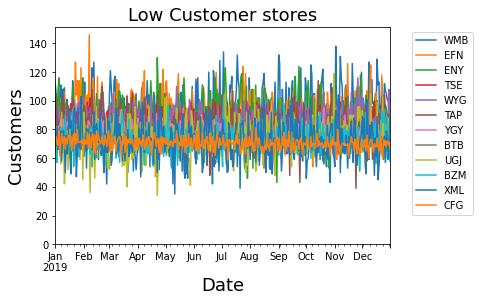

In [ ]:
plt.figure(figsize=[8,8])
customers_selected3.plot.line()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylim(0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Low Customer stores', fontsize= 18)
plt.show()

In [ ]:
customers_selected3.columns

Index(['WMB', 'EFN', 'ENY', 'TSE', 'WYG', 'TAP', 'YGY', 'BTB', 'UGJ', 'BZM',
       'XML', 'CFG'],
      dtype='object')

In [ ]:
selected = customers_reorder.columns[(customers_reorder.sum() < 25000)]
customers_selected4 = customers_reorder[selected]
print(customers_selected4.head())

            VYZ  VSM  UMU  CNQ  DTJ  DZT  ...  XSV  ZMS  NGB  YYO  MAJ  ZSD
Date                                      ...                              
2019-01-01   68   67   80   62   76   70  ...   71   63    0    0    0    0
2019-01-02   83   69   69   74   59   52  ...   86   70    0    0    0    0
2019-01-03   73   59   71   59   62   62  ...   60   42    0    0    0    0
2019-01-04   58   68   64   65   67   72  ...   98   52    0    0    0    0
2019-01-05   61   75   55   61   72   57  ...   87   68    0    0    0    0

[5 rows x 16 columns]


In [ ]:
customers_selected4.columns

Index(['VYZ', 'VSM', 'UMU', 'CNQ', 'DTJ', 'DZT', 'ATT', 'WGR', 'NMO', 'AEI',
       'XSV', 'ZMS', 'NGB', 'YYO', 'MAJ', 'ZSD'],
      dtype='object')

<Figure size 864x576 with 0 Axes>

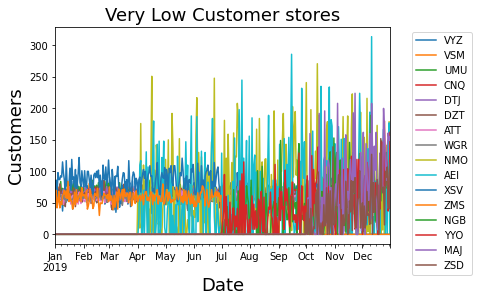

In [ ]:
plt.figure(figsize=[12,8])
customers_selected4.plot.line()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Very Low Customer stores', fontsize= 18)
plt.show()

From the plot of the very low customer stores we can see some stores opening and closing during the year, however we would further segement the stores to enhance visibility of the plot and also ascertain which stores opened and closed during the year. 

# Stores opened and Stores closed 
The very low volume stores require more investigation from the segmented plot to find stores that opened and closed during the year.

To achieve this, we further split the very low volume stores to avoid clutters in the line plot. 

In [ ]:
#Data filtering by columns name
selected = ['VYZ', 'VSM', 'UMU', 'CNQ', 'DTJ', 'DZT', 'ATT', 'WGR']
customers_selected4_1 = customers_reorder[selected]
print(customers_selected4_1.head())

            VYZ  VSM  UMU  CNQ  DTJ  DZT  ATT  WGR
Date                                              
2019-01-01   68   67   80   62   76   70   59   60
2019-01-02   83   69   69   74   59   52   57   55
2019-01-03   73   59   71   59   62   62   54   63
2019-01-04   58   68   64   65   67   72   58   52
2019-01-05   61   75   55   61   72   57   52   65


<Figure size 864x576 with 0 Axes>

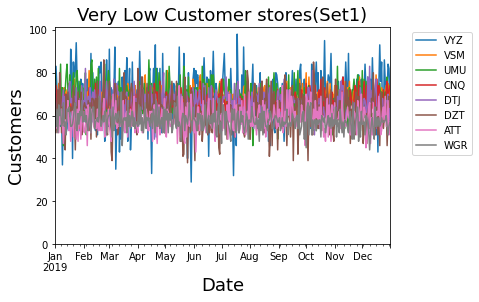

In [ ]:
plt.figure(figsize=[12,8])
customers_selected4_1.plot.line()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylim(0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Very Low Customer stores(Set1)', fontsize= 18)
plt.show()

In [ ]:
selected = [ 'NMO', 'AEI','XSV', 'ZMS', 'NGB', 'YYO', 'MAJ', 'ZSD']
customers_selected4_2 = customers_reorder[selected]
print(customers_selected4_2.head())

            NMO  AEI  XSV  ZMS  NGB  YYO  MAJ  ZSD
Date                                              
2019-01-01    0    0   71   63    0    0    0    0
2019-01-02    0    0   86   70    0    0    0    0
2019-01-03    0    0   60   42    0    0    0    0
2019-01-04    0    0   98   52    0    0    0    0
2019-01-05    0    0   87   68    0    0    0    0


<Figure size 864x576 with 0 Axes>

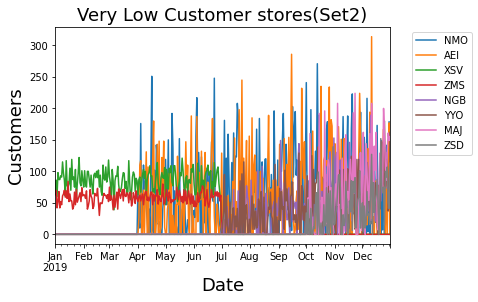

In [ ]:
plt.figure(figsize=[12,8])
customers_selected4_2.plot.line()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Very Low Customer stores(Set2)', fontsize= 18)
plt.show()

In [ ]:
selected = [ 'NMO', 'AEI','XSV', 'ZMS']
customers_selected4_3 = customers_reorder[selected]
print(customers_selected4_3.head())

            NMO  AEI  XSV  ZMS
Date                          
2019-01-01    0    0   71   63
2019-01-02    0    0   86   70
2019-01-03    0    0   60   42
2019-01-04    0    0   98   52
2019-01-05    0    0   87   68


<Figure size 1152x864 with 0 Axes>

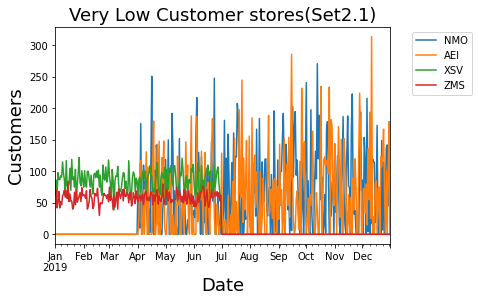

In [ ]:
plt.figure(figsize=[16,12])
customers_selected4_3.plot.line()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.title('Very Low Customer stores(Set2.1)', fontsize= 18)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.show()

In [ ]:
selected = [ 'NGB', 'YYO', 'MAJ', 'ZSD']
customers_selected4_4 = customers_reorder[selected]
print(customers_selected4_4.head())

            NGB  YYO  MAJ  ZSD
Date                          
2019-01-01    0    0    0    0
2019-01-02    0    0    0    0
2019-01-03    0    0    0    0
2019-01-04    0    0    0    0
2019-01-05    0    0    0    0


<Figure size 1152x864 with 0 Axes>

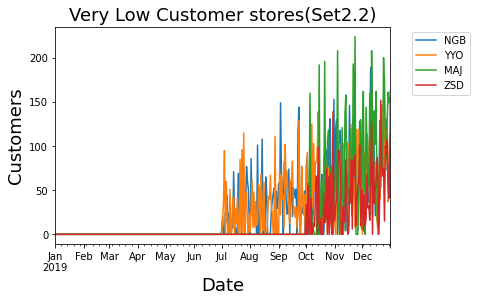

In [ ]:
plt.figure(figsize=[16,12])
customers_selected4_4.plot.line()
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.title('Very Low Customer stores(Set2.2)', fontsize= 18)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.show()

From the plots, the data is organized into stores that closed and stores that opened during the year. 

In [ ]:
selected = [ 'ZMS', 'XSV']
closed_stores = customers_reorder[selected]

In [ ]:
selected = [ 'NMO', 'AEI', 'NGB', 'YYO', 'MAJ', 'ZSD' ]
open_stores = customers_reorder[selected]

<Figure size 1152x864 with 0 Axes>

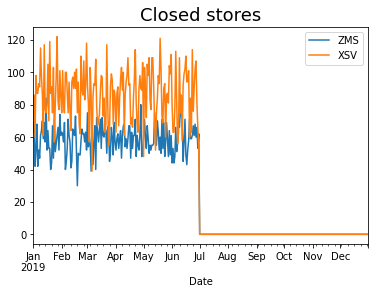

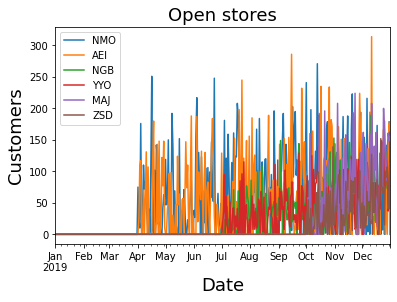

In [ ]:
plt.figure(figsize=[16,12])
closed_stores.plot.line()
plt.title('Closed stores', fontsize= 18)
open_stores.plot.line()
plt.legend( loc='best')
plt.title('Open stores', fontsize= 18)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.show()

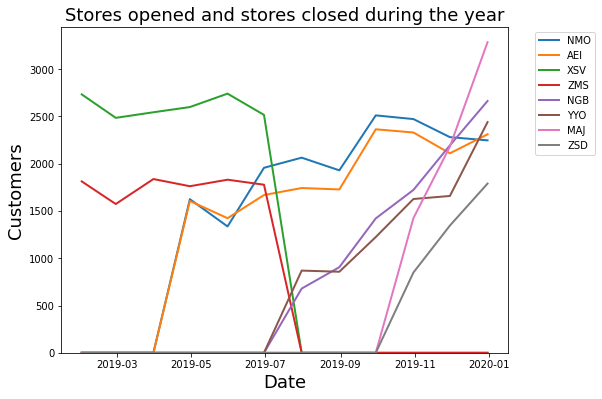

In [ ]:
sample_rate = 'M'  # Monthly
averaged_data = customers_selected4_2.resample(sample_rate).sum()
plt.figure(figsize=(8,6))
plt.plot(averaged_data, linewidth=2)
plt.legend(customers_selected4_2, bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylim(0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Stores opened and stores closed during the year', fontsize= 18)
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
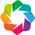

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

<Figure size 432x432 with 0 Axes>

In [ ]:
#Interactive plot of stores opening and closing during the year
period = 28
rolling_average = customers_selected4_2.rolling(window=period).mean()

plt.figure(figsize=(6, 6))
plot = rolling_average.hvplot.line(
    frame_height=400, frame_width=500,
    xlabel='Date', ylabel='Customers',
    title='Stores opened and stores closed during the year'
)
hv.extension('bokeh')
plot



**Interactive chart functionalities**


Pan- Enables interactively following a data point in the plot. It also used to move the chart in any desired direction. 

Box Zoom- This feature enables zooming in and out of the chart, enabling the discovery of insights at a higher level. 

Save- This feature is used to save charts, either in their original form or charts zoomed in or out. 

Hover- Hover is used to move the chart in any direction upwards or downwards, left or right. This gives the user flexibility in using the interactive chart.

After segementing the very low stores;
*   XSV and ZMS closed in July
*   AEI, NGB, NMO, MAJ,YYO and ZSD opened during the year. AEI and NMO opened in April, NGB and YYO opened in July and MAJ and ZSD opened in October.




In [ ]:
# We use a copy of the reorder data to avoid altering the parent dataframe while plotting the piechart
customers_piechart = customers_reorder.copy()

In [ ]:
customers_piechart.columns

Index(['RAH', 'SMM', 'SGA', 'QSN', 'RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL',
       'OMV', 'MUY', 'WMB', 'EFN', 'ENY', 'TSE', 'WYG', 'TAP', 'YGY', 'BTB',
       'UGJ', 'BZM', 'XML', 'CFG', 'VYZ', 'VSM', 'UMU', 'CNQ', 'DTJ', 'DZT',
       'ATT', 'WGR', 'NMO', 'AEI', 'XSV', 'ZMS', 'NGB', 'YYO', 'MAJ', 'ZSD'],
      dtype='object')

             RAH   SMM   SGA   QSN  RGS  PAA  ...  NAQ  OSG  PGL  OMV  MUY  Others
Date                                          ...                                 
2019-01-01  1124  1026  1027  1080  515  408  ...  432  405  412  414  288    1671
2019-01-02   980   985   970   740  614  497  ...  389  493  452  429  355    1672
2019-01-03   937   885  1109   683  369  357  ...  466  429  361  327  304    1565
2019-01-04   879   829   970   691  384  456  ...  401  339  299  371  318    1631
2019-01-05   932   829   792   610  408  373  ...  265  332  363  287  281    1645

[5 rows x 13 columns]


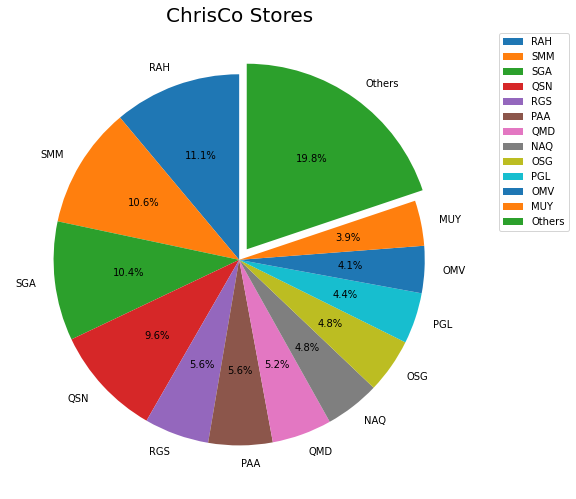

In [ ]:
explodeList = []
selected = []
columns = customers_piechart.columns
customers_piechart['Others'] = [0] * len(customers_piechart.index)
for name in columns:
    total_stores = customers_piechart[name].sum()
    if total_stores > 100000:
        selected.append(name)
        explodeList.append(0)
    else:
        customers_piechart['Others'] += customers_piechart[name]
selected.append('Others')
explodeList.append(0.07)
print(customers_piechart[selected].head())

plt.figure(figsize=(8, 8))
plt.pie(customers_piechart[selected].sum(), labels=selected, autopct='%1.1f%%', startangle=90, explode=explodeList)
plt.title('ChrisCo Stores', fontsize=20)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.tight_layout()
plt.show()


In [ ]:
customers_reorder.columns

Index(['RAH', 'SMM', 'SGA', 'QSN', 'RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL',
       'OMV', 'MUY', 'WMB', 'EFN', 'ENY', 'TSE', 'WYG', 'TAP', 'YGY', 'BTB',
       'UGJ', 'BZM', 'XML', 'CFG', 'VYZ', 'VSM', 'UMU', 'CNQ', 'DTJ', 'DZT',
       'ATT', 'WGR', 'NMO', 'AEI', 'XSV', 'ZMS', 'NGB', 'YYO', 'MAJ', 'ZSD'],
      dtype='object')

From the pie chart the high and medium customer stores contribute 80.2% of ChrisCo total customers, however the low and very low stores contribute 19.8% of the total customers which amounts to around 630,000 customers.
The total low and very low volume stores are not insignificant

#Time Series


**High Volume Stores**

<Figure size 1152x864 with 0 Axes>

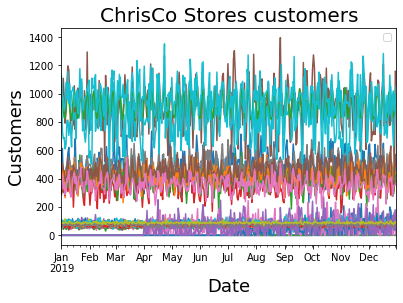

In [ ]:
plt.figure(figsize=[16,12])
customers.plot.line()
plt.legend([])
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('ChrisCo Stores customers', fontsize=20)
plt.show()

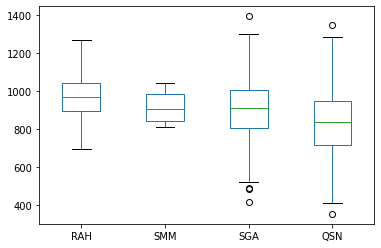

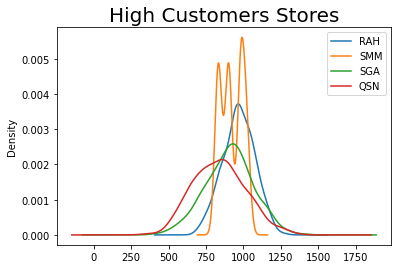

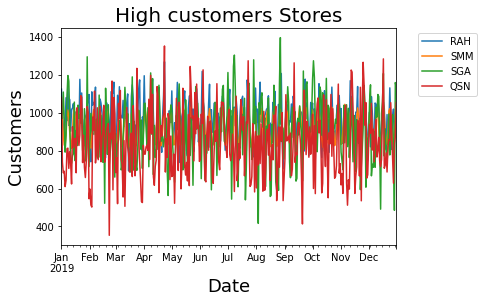

In [ ]:
customers_selected1
customers_selected1.plot.box()
plt.show()
customers_selected1.plot.density()
plt.title('High Customers Stores', fontsize=20)
plt.show()
customers_selected1.plot.line()
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High customers Stores', fontsize=20)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

We can see that
* The High volume stores are closely parked.
* QSN appears to be very noisy with high peaks and troughs 
* SMM and RAH appear to be more consistent, falling slightly towards the end of the year
* SGA also appears to be noise with consistent spikes in its customer volume over the year.

                    RAH         SMM         SGA         QSN
Date                                                       
2019-01-06   988.500000  906.833333  958.166667  741.166667
2019-01-13  1008.714286  916.285714  950.714286  772.571429
2019-01-20   950.142857  919.285714  904.142857  852.857143
2019-01-27   997.428571  918.285714  914.857143  863.000000
2019-02-03   982.571429  914.714286  906.285714  705.285714


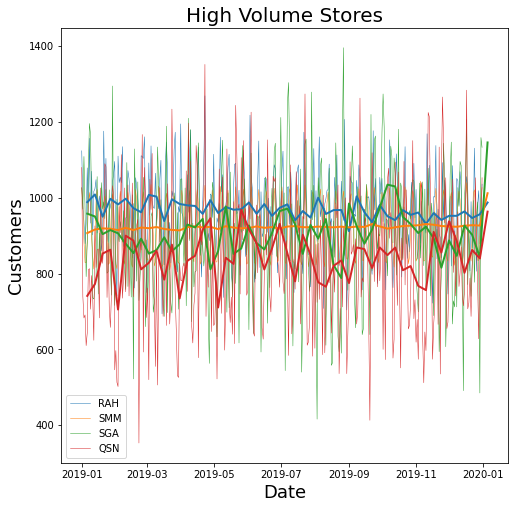

In [ ]:
sample_rate = 'W'  # weekly
averaged_data = customers_selected1.resample(sample_rate).mean()
print(averaged_data.head())
plt.figure(figsize=(8, 8))
plt.plot(customers_selected1, linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(averaged_data, linewidth=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High Volume Stores', fontsize=20)
plt.legend(customers_selected1, loc='best')
plt.show()


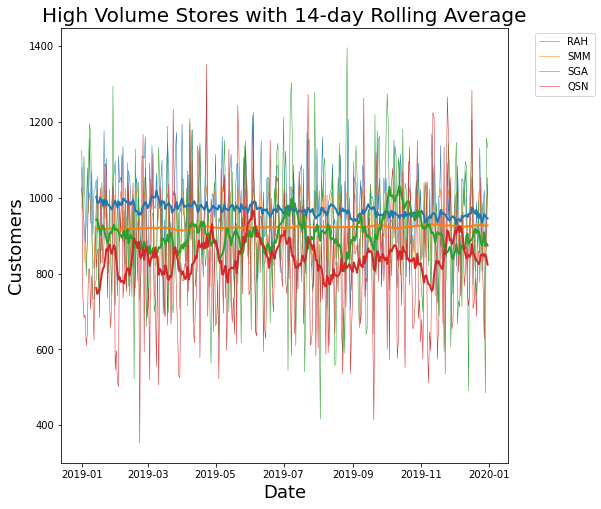

In [ ]:
#rolling averages 1-14 if n = 14 

period = 14
rolling_average = customers_selected1.rolling(window=period).mean()

plt.figure(figsize=(8, 8))
plt.plot(customers_selected1, linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average, linewidth=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High Volume Stores with 14-day Rolling Average', fontsize=20)
plt.legend(customers_selected1,bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()


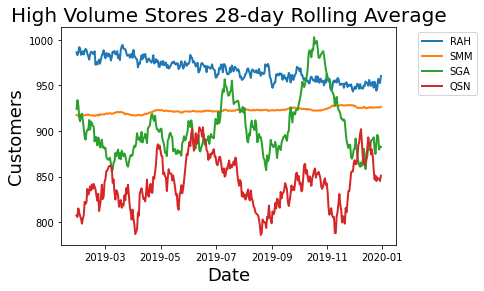

In [ ]:
period = 28
rolling_average = customers_selected1.rolling(window=period).mean()

plt.plot(rolling_average, linewidth=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High Volume Stores 28-day Rolling Average', fontsize=20)
plt.legend(customers_selected1,bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

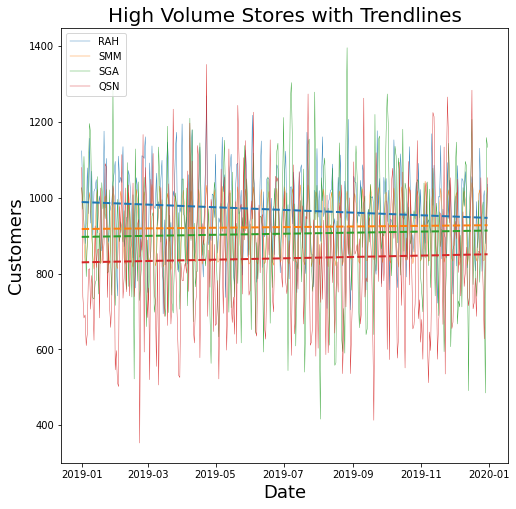

In [ ]:
plt.figure(figsize=(8, 8))
plt.plot(customers_selected1, linewidth=0.4)
plt.gca().set_prop_cycle(None)
for name in customers_selected1:
    x = np.arange(len(customers_selected1[name]))
    z = np.polyfit(x, customers_selected1[name], 1)
    trend = np.poly1d(z)
    plt.plot(customers_selected1.index, trend(x), linestyle='--', linewidth =2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High Volume Stores with Trendlines', fontsize=20)
plt.legend(customers_selected1, loc=2)
plt.show()


The data is quite noisy, hence rolling avergaes and trendlines are used to investigate the high volume stores further.

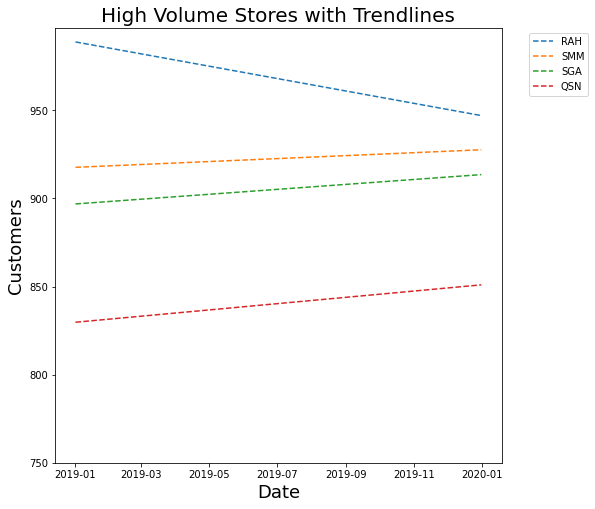

In [ ]:
plt.figure(figsize=(8, 8))
for name in customers_selected1:
    x = np.arange(len(customers_selected1[name]))
    z = np.polyfit(x, customers_selected1[name], 1)
    trend = np.poly1d(z)
    plt.plot(customers_selected2.index, trend(x), linestyle='--')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.ylim(750)
plt.title('High Volume Stores with Trendlines', fontsize=20)
plt.legend(customers_selected1, bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

From the trendlines, RAH has the highest volume of customers. However, its volume is falling over the year, while the other three stores experience a steady rise in customer volume over the year.

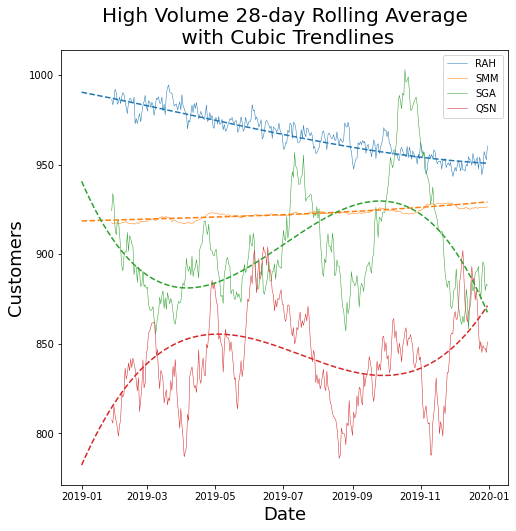

In [ ]:
sample_rate = 'SM'  # weekly
averaged_data = customers_selected1.resample(sample_rate).mean()
period = 28
rolling_average = customers_selected1.rolling(window=period).mean()

plt.figure(figsize=(8, 8))
plt.plot(rolling_average, linewidth=0.5)
plt.gca().set_prop_cycle(None)
for name in customers_selected1:
    x = np.arange(len(customers_selected1[name]))
    z = np.polyfit(x, customers_selected1[name], 3)
    trend = np.poly1d(z)
    plt.plot(customers_selected1.index, trend(x), linestyle='--')
# plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High Volume 28-day Rolling Average\n with Cubic Trendlines', fontsize=20)
plt.legend(customers_selected1, loc='best')
plt.show()


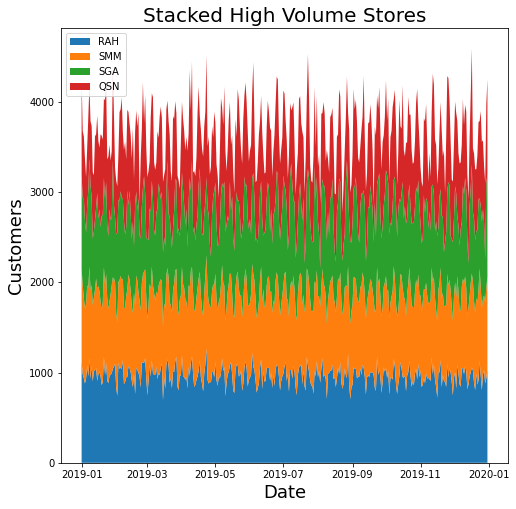

In [ ]:
plt.figure(figsize=(8, 8))
plt.stackplot(customers_selected1.index, customers_selected1.transpose())
plt.legend(customers_selected1.columns, loc=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Stacked High Volume Stores', fontsize=20)
plt.show()


<Figure size 864x864 with 0 Axes>

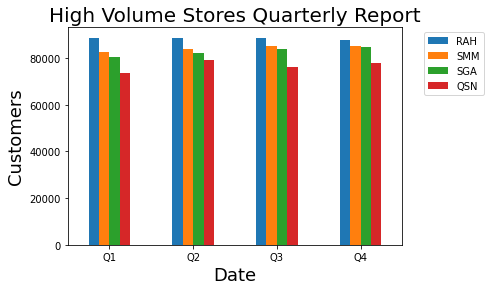

In [ ]:
sample_rate = 'Q'  # Quarterly
averaged_data_selected1 = customers_selected1.resample(sample_rate).sum()

plt.figure(figsize=[12,12])
averaged_data_selected1.plot(kind= 'bar')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
degrees = 0
plt.xticks([0,1,2,3], ["Q1", "Q2", "Q3", "Q4"], rotation = degrees)
plt.title('High Volume Stores Quarterly Report', fontsize=20)
plt.legend(customers_selected1,bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

**Medium Volume stores**

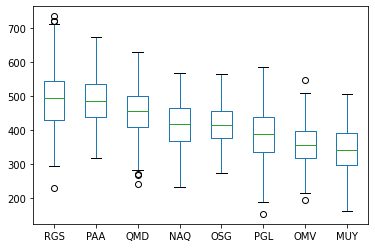

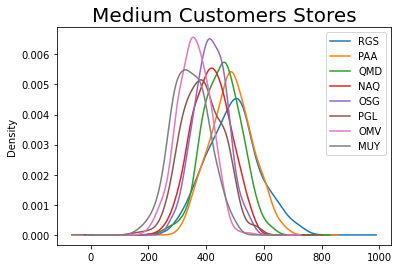

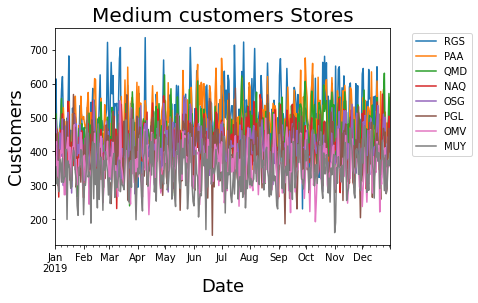

In [ ]:
customers_selected2
customers_selected2.plot.box()
plt.show()
customers_selected2.plot.density()
plt.title('Medium Customers Stores', fontsize=20)
plt.show()
customers_selected2.plot.line()
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Medium customers Stores', fontsize=20)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()


                   RGS         PAA  ...         OMV         MUY
Date                                ...                        
2019-01-06  460.500000  425.666667  ...  358.333333  320.500000
2019-01-13  481.571429  487.285714  ...  365.428571  345.142857
2019-01-20  478.571429  444.428571  ...  388.857143  320.142857
2019-01-27  436.000000  462.714286  ...  372.000000  322.571429
2019-02-03  447.571429  489.857143  ...  371.857143  330.000000

[5 rows x 8 columns]


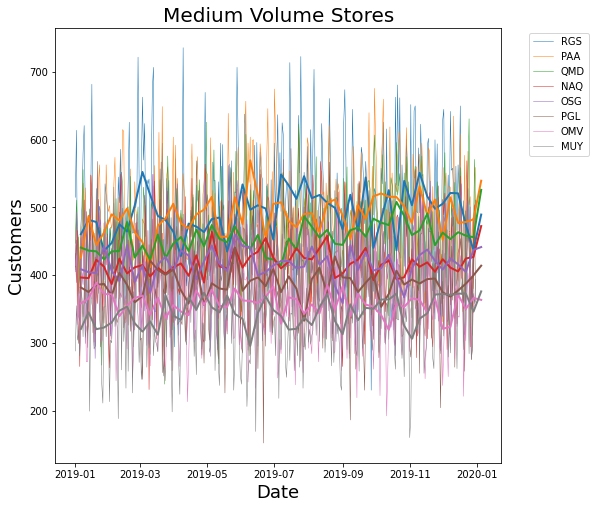

In [ ]:
sample_rate = 'W'  # weekly
averaged_data = customers_selected2.resample(sample_rate).mean()
print(averaged_data.head())
plt.figure(figsize=(8, 8))
plt.plot(customers_selected2, linewidth=0.5)
plt.legend(customers_selected2, bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.gca().set_prop_cycle(None)
plt.plot(averaged_data, linewidth=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Medium Volume Stores', fontsize=20)
plt.show()


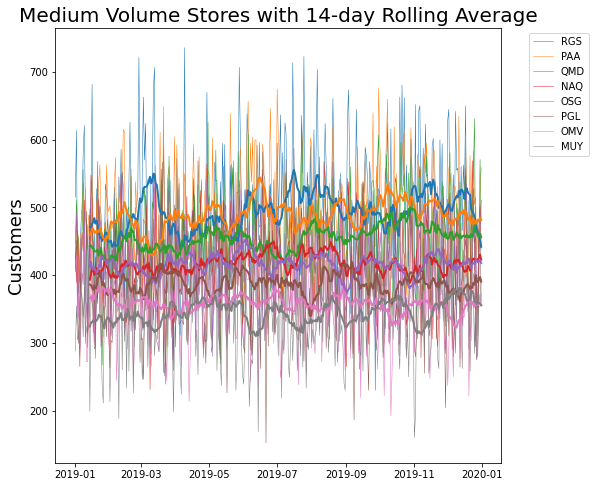

In [ ]:
#rolling averages 1-14 if n = 14 

period = 14
rolling_average = customers_selected2.rolling(window=period).mean()

plt.figure(figsize=(8, 8))
plt.plot(customers_selected2, linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average, linewidth=2)
plt.ylabel('Customers', fontsize=18)
plt.title('Medium Volume Stores with 14-day Rolling Average', fontsize=20)
plt.legend(rolling_average, bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

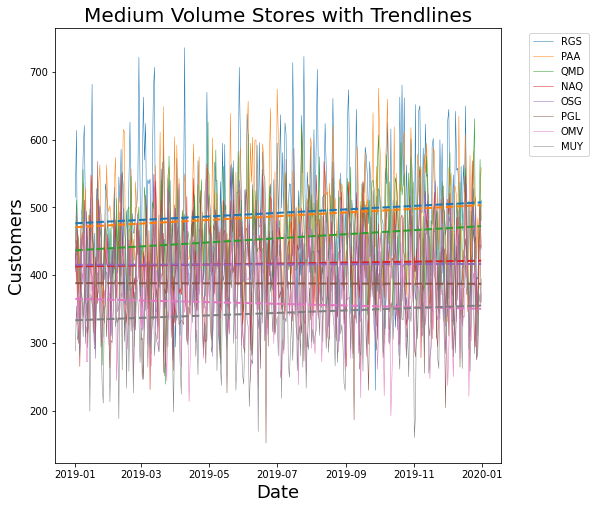

In [ ]:
plt.figure(figsize=(8, 8))
plt.plot(customers_selected2, linewidth=0.5)
plt.gca().set_prop_cycle(None)
for name in customers_selected2:
    x = np.arange(len(customers_selected2[name]))
    z = np.polyfit(x, customers_selected2[name], 1)
    trend = np.poly1d(z)
    plt.plot(customers_selected2.index, trend(x), linestyle='--', linewidth =2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Medium Volume Stores with Trendlines', fontsize=20)
plt.legend(customers_selected2, bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

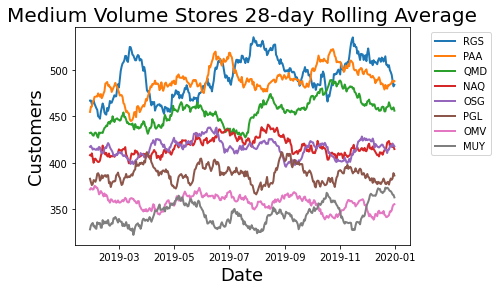

In [ ]:
period = 28
rolling_average = customers_selected2.rolling(window=period).mean()

plt.plot(rolling_average, linewidth=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Medium Volume Stores 28-day Rolling Average', fontsize=20)
plt.legend(customers_selected2,bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

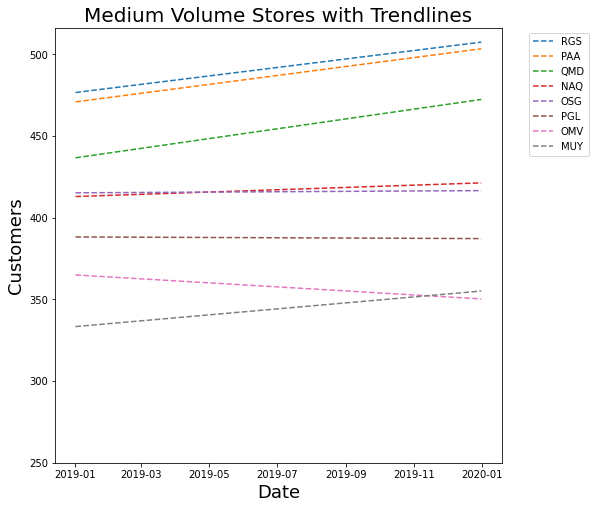

In [ ]:
plt.figure(figsize=(8, 8))
for name in customers_selected2:
    x = np.arange(len(customers_selected2[name]))
    z = np.polyfit(x, customers_selected2[name], 1)
    trend = np.poly1d(z)
    plt.plot(customers_selected2.index, trend(x), linestyle='--')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.ylim(250)
plt.title('Medium Volume Stores with Trendlines', fontsize=20)
plt.legend(customers_selected2, bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

Trendlines and rolling averages are use to further investigate the medium volume stores as the data is closely packed and noisy. 

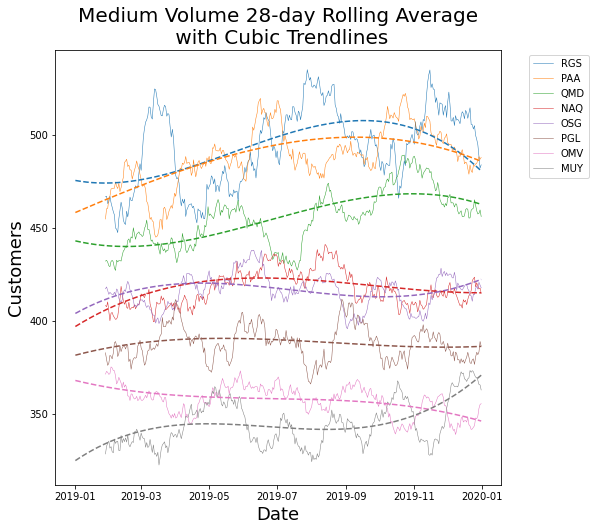

In [ ]:
period = 28
rolling_average = customers_selected2.rolling(window=period).mean()

plt.figure(figsize=(8, 8))
plt.plot(rolling_average, linewidth=0.5)
plt.gca().set_prop_cycle(None)
for name in customers_selected2:
    x = np.arange(len(customers_selected2[name]))
    z = np.polyfit(x, customers_selected2[name], 3)
    trend = np.poly1d(z)
    plt.plot(customers_selected2.index, trend(x), linestyle='--')
# plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Medium Volume 28-day Rolling Average\n with Cubic Trendlines', fontsize=20)
plt.legend(rolling_average, bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

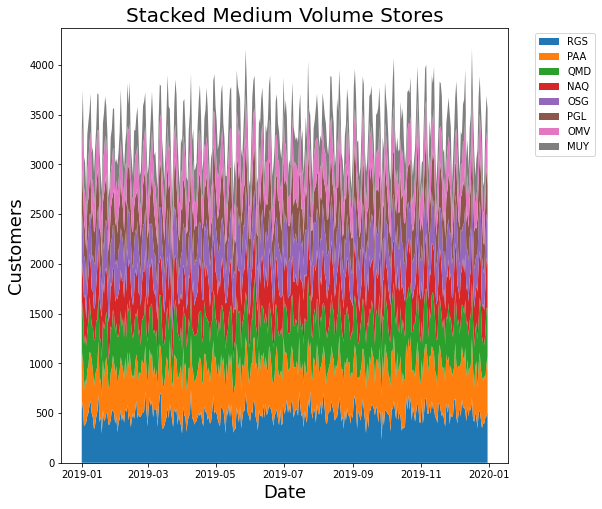

In [ ]:
plt.figure(figsize=(8, 8))
plt.stackplot(customers_selected2.index, customers_selected2.transpose())
plt.legend(rolling_average, bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Stacked Medium Volume Stores', fontsize=20)
plt.show()

<Figure size 864x864 with 0 Axes>

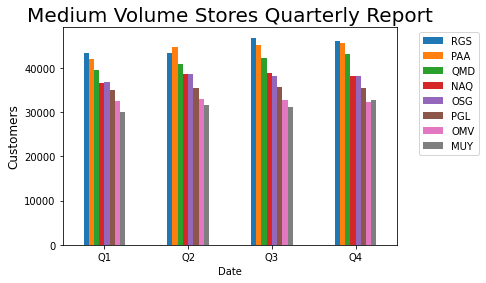

In [ ]:
sample_rate = 'Q'  # Quarterly
averaged_data_selected2 = customers_selected2.resample(sample_rate).sum()

plt.figure(figsize=[12,12])
averaged_data_selected2.plot(kind= 'bar')
plt.ylabel('Customers', fontsize=12)
degrees = 0
plt.xticks([0,1,2,3], ["Q1", "Q2", "Q3", "Q4"], rotation = degrees)
plt.title('Medium Volume Stores Quarterly Report', fontsize=20)
plt.legend(customers_selected2,bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

Low volume stores

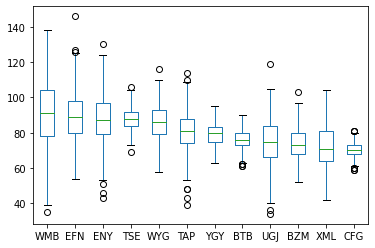

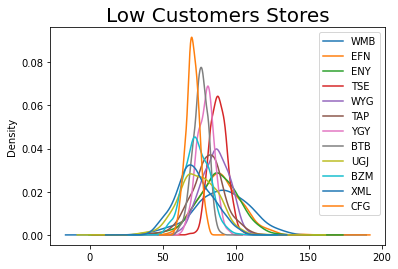

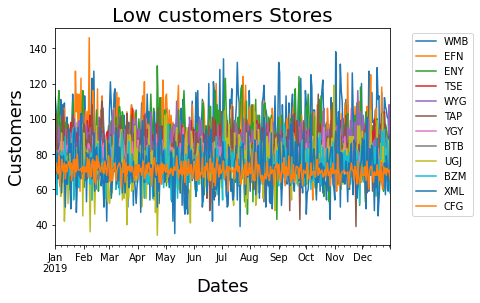

In [ ]:
customers_selected3
customers_selected3.plot.box()
plt.show()
customers_selected3.plot.density()
plt.title('Low Customers Stores', fontsize=20)
plt.show()
customers_selected3.plot.line()
plt.xlabel('Dates', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Low customers Stores', fontsize=20)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()


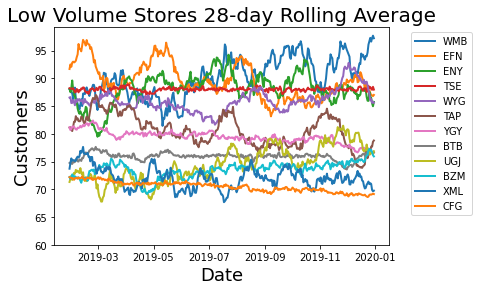

In [ ]:
period = 28
rolling_average = customers_selected3.rolling(window=period).mean()

plt.plot(rolling_average, linewidth=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.ylim(60)
plt.title('Low Volume Stores 28-day Rolling Average', fontsize=20)
plt.legend(customers_selected3,bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

# Correlation

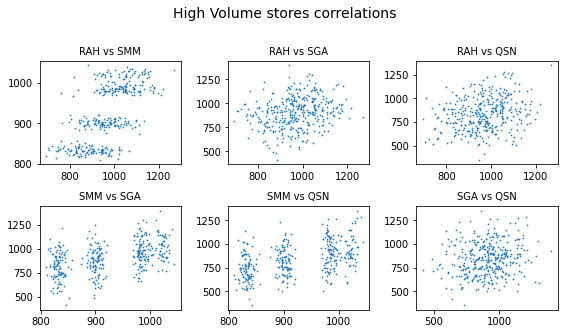

In [ ]:
#High volume correlation analysis 

selected = ['RAH', 'SMM', 'SGA', 'QSN']

counter = 1
fig = plt.figure(figsize=(8, 8))
fig.suptitle('High Volume stores correlations', fontsize=14, position=(0.5, 1.05))
for i, name_i in enumerate(selected):
    for j in range(i + 1, len(selected)):
        name_j = selected[j]
        sub = fig.add_subplot(4, 3, counter)
        sub.set_title(name_i + ' vs ' + name_j, fontsize=10)
        sub.scatter(customers_reorder[name_i], customers_reorder[name_j], s=0.5)
        counter += 1
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()


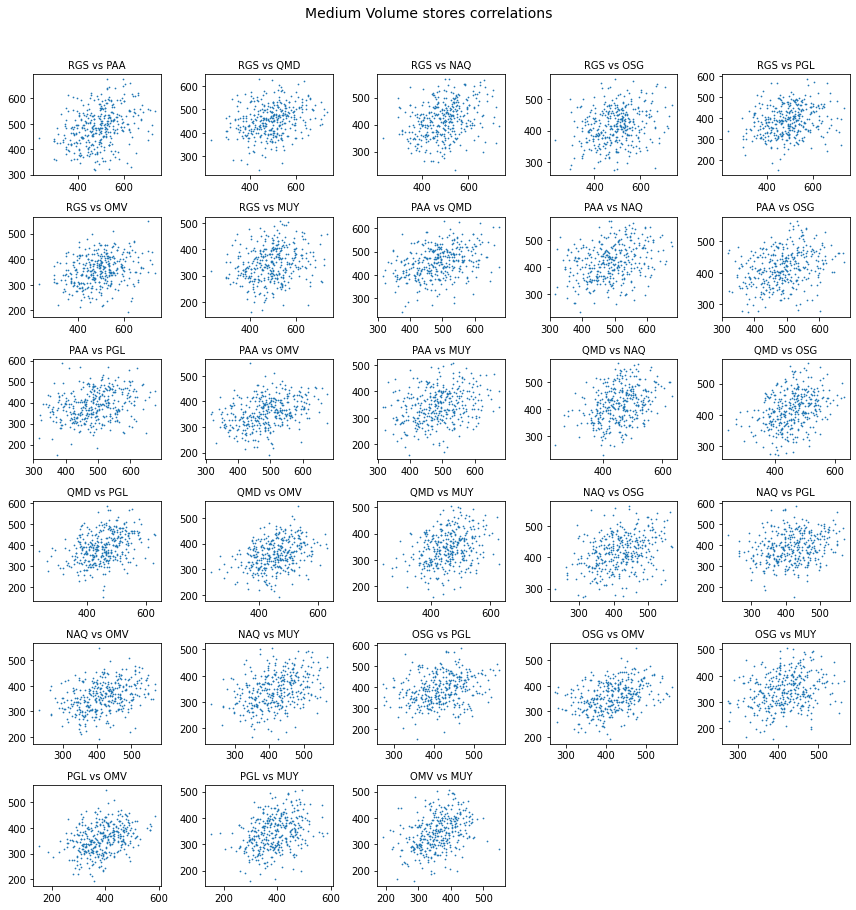

In [ ]:

selected = ['RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY']
counter = 1
fig = plt.figure(figsize=(12, 12))
fig.suptitle('Medium Volume stores correlations', fontsize=14, position=(0.5, 1.05))
for i, name_i in enumerate(selected):
    for j in range(i + 1, len(selected)):
        name_j = selected[j]
        sub = fig.add_subplot(6, 5, counter)
        sub.set_title(name_i + ' vs ' + name_j, fontsize=10)
        sub.scatter(customers_reorder[name_i], customers_reorder[name_j], s=0.5)
        counter += 1
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()

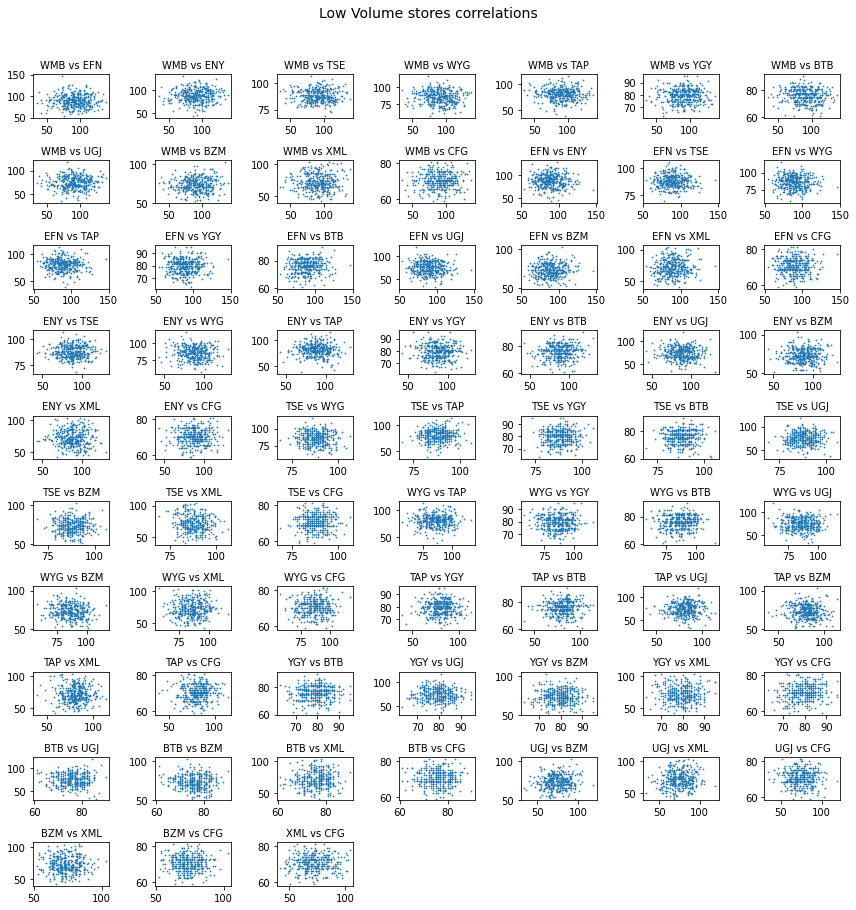

In [ ]:

selected =['WMB', 'EFN', 'ENY', 'TSE', 'WYG', 'TAP', 'YGY', 'BTB', 'UGJ', 'BZM','XML', 'CFG']
counter = 1
fig = plt.figure(figsize=(12, 12))
fig.suptitle('Low Volume stores correlations', fontsize=14, position=(0.5, 1.05))
for i, name_i in enumerate(selected):
    for j in range(i + 1, len(selected)):
        name_j = selected[j]
        sub = fig.add_subplot(10, 7, counter)
        sub.set_title(name_i + ' vs ' + name_j, fontsize=10)
        sub.scatter(customers_reorder[name_i], customers_reorder[name_j], s=0.5)
        counter += 1
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()

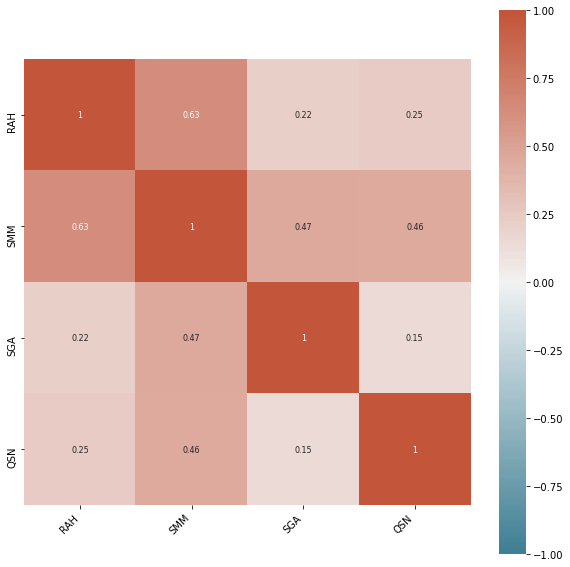

In [ ]:
plt.figure(figsize=(10, 10))
corr = customers_selected1.corr()
ax = sns.heatmap(corr, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(220, 20, n=200), square=True, annot=True,
                 annot_kws={"size": 8})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()


In [ ]:
print((customers_selected1.corr()>0.5).sum())
print((customers_selected1.corr()<-0.55).sum())

# Stores with value count of 2 and above are correlated (RAH, SMM)

RAH    2
SMM    2
SGA    1
QSN    1
dtype: int64
RAH    0
SMM    0
SGA    0
QSN    0
dtype: int64


             RAH   SMM
Date                  
2019-01-01  1124  1026
2019-01-02   980   985
2019-01-03   937   885
2019-01-04   879   829
2019-01-05   932   829
                    RAH         SMM
Date                               
2019-01-06   988.500000  906.833333
2019-01-13  1008.714286  916.285714
2019-01-20   950.142857  919.285714
2019-01-27   997.428571  918.285714
2019-02-03   982.571429  914.714286


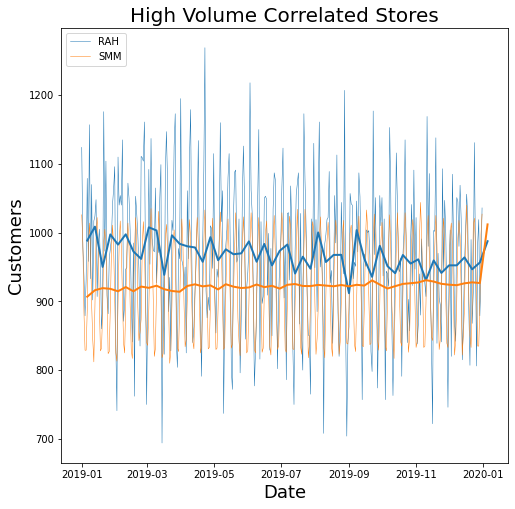

In [ ]:
sample_rate = 'W'  # weekly
averaged_data = customers_selected1.resample(sample_rate).mean()

selected = ['RAH', 'SMM']
print(customers_selected1[selected].head())
print(averaged_data[selected].head())

plt.figure(figsize=(8, 8))
plt.plot(customers_selected1[selected], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(averaged_data[selected], linewidth=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High Volume Correlated Stores', fontsize=20)
plt.legend(selected, loc=2)
plt.show()


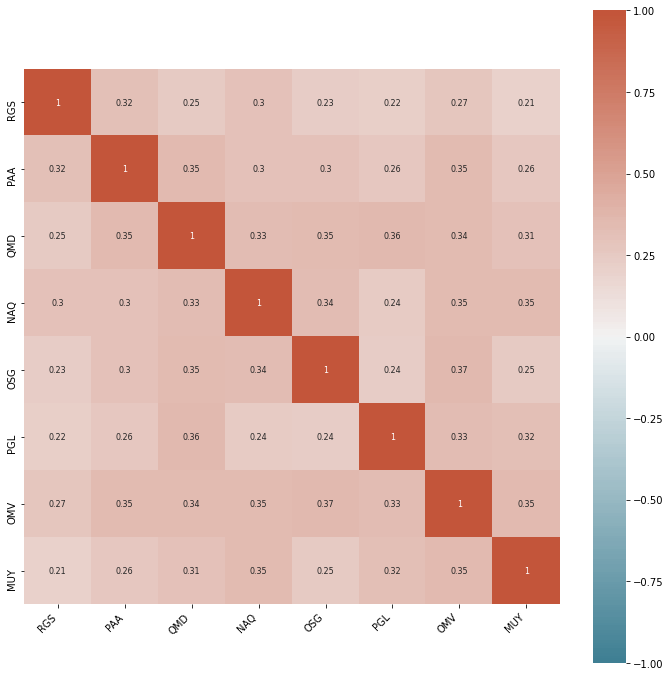

In [ ]:
plt.figure(figsize=(12, 12))
corr = customers_selected2.corr()
ax = sns.heatmap(corr, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(220, 20, n=200), square=True, annot=True,
                 annot_kws={"size": 8})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

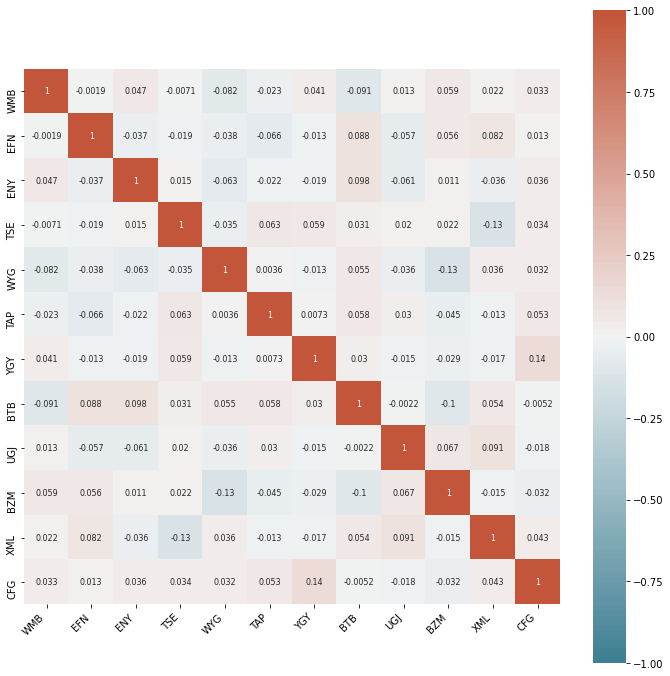

In [ ]:
plt.figure(figsize=(12, 12))
corr = customers_selected3.corr()
ax = sns.heatmap(corr, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(220, 20, n=200), square=True, annot=True,
                 annot_kws={"size": 8})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

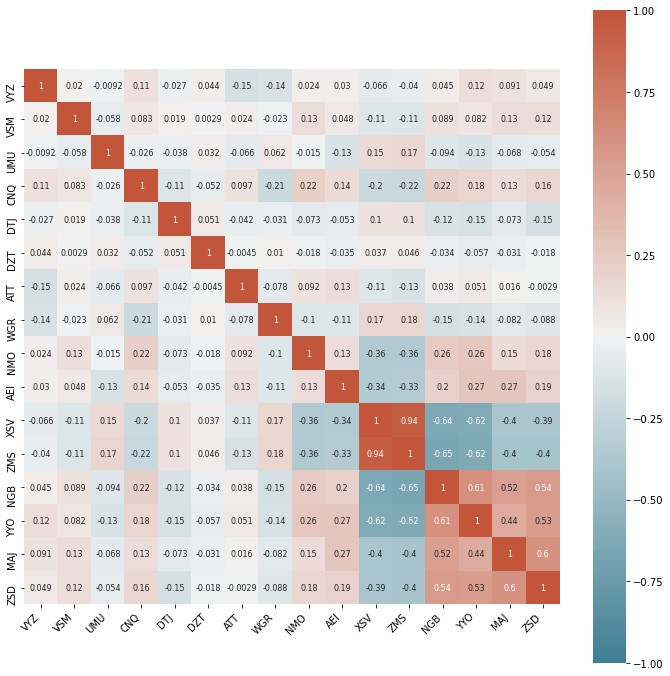

In [ ]:
plt.figure(figsize=(12, 12))
corr = customers_selected4.corr()
ax = sns.heatmap(corr, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(220, 20, n=200), square=True, annot=True,
                 annot_kws={"size": 8})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

In [ ]:
print((customers_selected4.corr()>0.5).sum())
print((customers_selected4.corr()<-0.55).sum())

# Stores with value count of 2 and above are correlated (XSV,ZMS,NGB,YYO,MAJ,ZSD)

VYZ    1
VSM    1
UMU    1
CNQ    1
DTJ    1
DZT    1
ATT    1
WGR    1
NMO    1
AEI    1
XSV    2
ZMS    2
NGB    4
YYO    3
MAJ    3
ZSD    4
dtype: int64
VYZ    0
VSM    0
UMU    0
CNQ    0
DTJ    0
DZT    0
ATT    0
WGR    0
NMO    0
AEI    0
XSV    2
ZMS    2
NGB    2
YYO    2
MAJ    0
ZSD    0
dtype: int64


            XSV  ZMS  NGB  YYO  MAJ  ZSD
Date                                    
2019-01-01   71   63    0    0    0    0
2019-01-02   86   70    0    0    0    0
2019-01-03   60   42    0    0    0    0
2019-01-04   98   52    0    0    0    0
2019-01-05   87   68    0    0    0    0
                  XSV        ZMS  NGB  YYO  MAJ  ZSD
Date                                                
2019-01-31  88.129032  58.451613  0.0  0.0  0.0  0.0
2019-02-28  88.714286  56.178571  0.0  0.0  0.0  0.0
2019-03-31  82.032258  59.258065  0.0  0.0  0.0  0.0
2019-04-30  86.600000  58.700000  0.0  0.0  0.0  0.0
2019-05-31  88.387097  59.032258  0.0  0.0  0.0  0.0


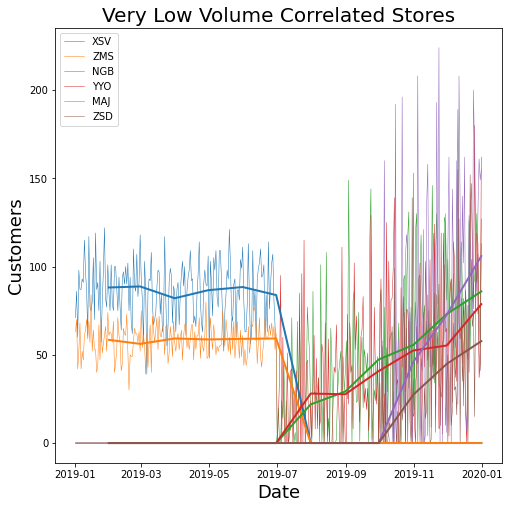

In [ ]:
sample_rate = 'M'  # weekly
averaged_data = customers_selected4.resample(sample_rate).mean()

selected = ['XSV','ZMS','NGB','YYO','MAJ','ZSD']
print(customers_selected4[selected].head())
print(averaged_data[selected].head())

plt.figure(figsize=(8, 8))
plt.plot(customers_selected4[selected], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(averaged_data[selected], linewidth=2)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Very Low Volume Correlated Stores', fontsize=20)
plt.legend(selected, loc=2)
plt.show()


In [ ]:
summary_data

,Customers,Store_size,Staff,Marketing,Overhead
RGS,179589,1851,9,18000,52000
NAQ,152253,1426,6,18000,19000
BTB,27702,424,3,4000,44000
MUY,125653,2252,17,15000,82000
EFN,32629,209,2,4000,66000
CNQ,24093,221,2,3000,84000
UGJ,27202,415,4,3000,88000
ZSD,3983,31,1,1000,67000
TAP,29460,305,2,3000,57000
NGB,9582,124,1,1000,97000


In [ ]:
#Sorting the summary data in a descending order based on the number of customers 
summary_data.sort_values(by=['Marketing'], ascending= False)

,Customers,Store_size,Staff,Marketing,Overhead
RAH,353292,7040,49,40000,14000
SGA,330402,6579,61,36000,97000
QSN,306734,5946,35,34000,89000
SMM,336765,7441,46,29000,26000
NAQ,152253,1426,6,18000,19000
RGS,179589,1851,9,18000,52000
PGL,141518,887,6,15000,15000
PAA,177802,2047,13,15000,54000
QMD,165896,2506,11,15000,61000
MUY,125653,2252,17,15000,82000


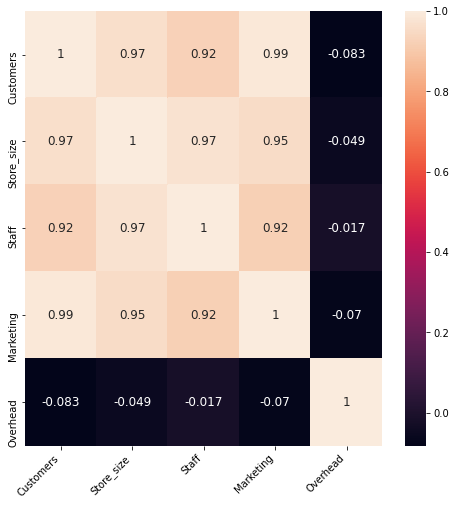

In [ ]:
plt.figure(figsize=(8, 8))
corr = summary_data.corr()
ax = sns.heatmap(corr,annot=True,annot_kws={"size": 12})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()


There is a strong positive correlation between marketing, store size, staff strength and customer volume. 

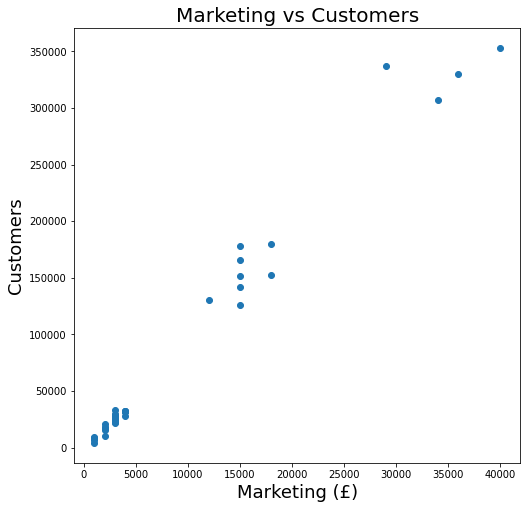

In [ ]:
plt.figure(figsize=(8, 8))
plt.scatter(summary_data['Marketing'], summary_data['Customers'])
plt.title('Marketing vs Customers', fontsize=20)
plt.xlabel('Marketing (£)', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.show()


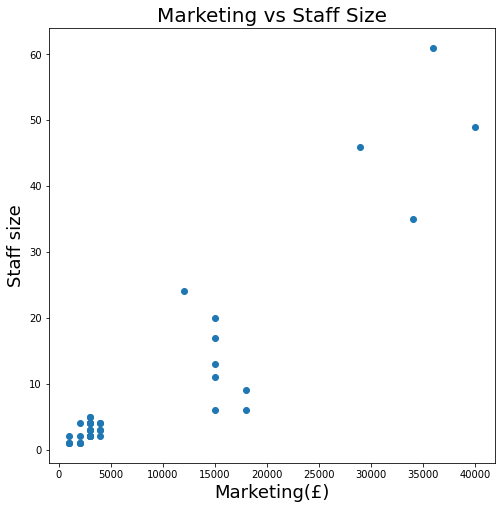

In [ ]:
plt.figure(figsize=(8, 8))
plt.scatter(summary_data['Marketing'], summary_data['Staff'])
plt.title('Marketing vs Staff Size', fontsize=20)
plt.xlabel('Marketing(£)', fontsize=18)
plt.ylabel('Staff size', fontsize=18)
plt.show()


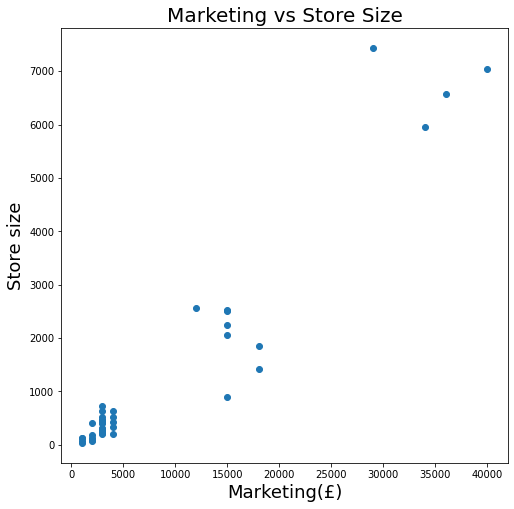

In [ ]:
plt.figure(figsize=(8, 8))
plt.scatter(summary_data['Marketing'], summary_data['Store_size'])
plt.title('Marketing vs Store Size', fontsize=20)
plt.xlabel('Marketing(£)', fontsize=18)
plt.ylabel('Store size', fontsize=18)
plt.show()


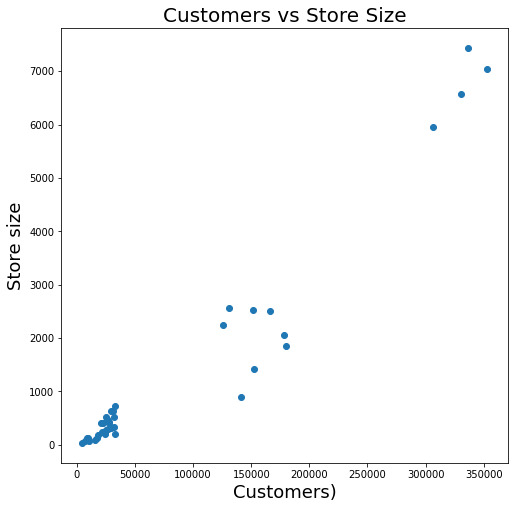

In [ ]:
plt.figure(figsize=(8, 8))
plt.scatter(summary_data['Customers'], summary_data['Store_size'])
plt.title('Customers vs Store Size', fontsize=20)
plt.xlabel('Customers)', fontsize=18)
plt.ylabel('Store size', fontsize=18)
plt.show()

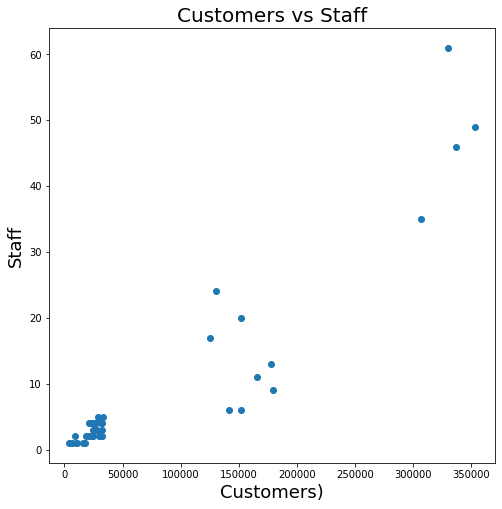

In [ ]:
plt.figure(figsize=(8, 8))
plt.scatter(summary_data['Customers'], summary_data['Staff'])
plt.title('Customers vs Staff', fontsize=20)
plt.xlabel('Customers)', fontsize=18)
plt.ylabel('Staff', fontsize=18)
plt.show()

#Distribution

21 bins


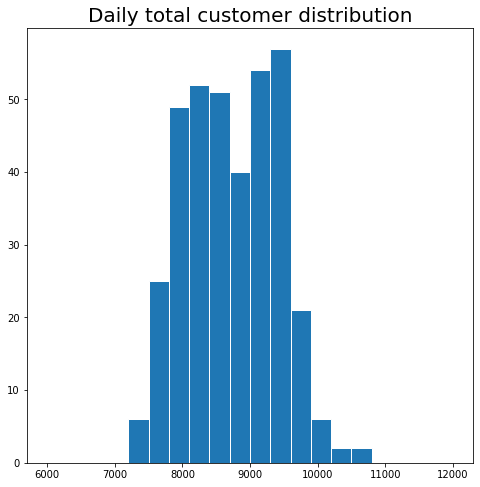

In [ ]:
x_min = 6000
x_max = 12000
bin_width =300

n_bins = int((bin_width + x_max - x_min) / bin_width)
print(str(n_bins) + ' bins')
bins = [(x_min + x * (bin_width + x_max - x_min) / n_bins) for x in range(int(n_bins))]

plt.figure(figsize=(8, 8))
plt.hist(customers_reorder.sum(axis=1), bins, edgecolor='w')
plt.title('Daily total customer distribution', fontsize=20)
plt.show()


The Distribution is approximately bell shaped, slighlty skewed to the right. 
The tallest column is above 55 for bins 9300 to 9599. This means there were 55 plus days where the total number of customers where between 9300 and 9599 customers.

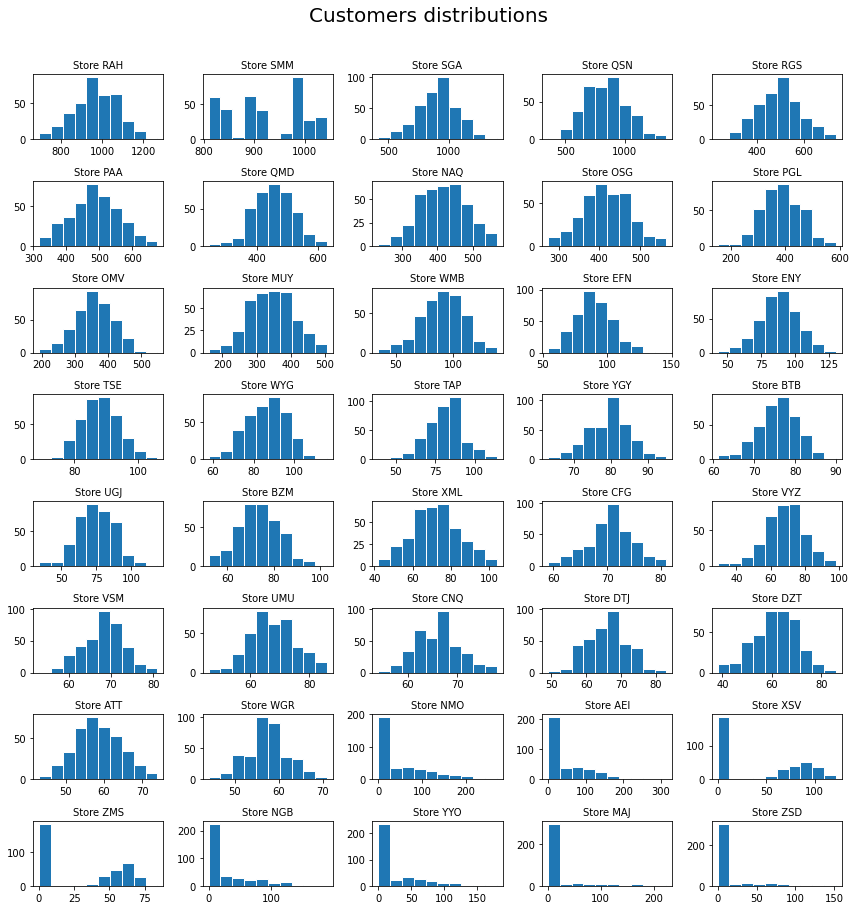

In [ ]:
counter = 1
fig = plt.figure(figsize=(12, 12))
fig.suptitle('Customers distributions', fontsize=20, position=(0.5, 1.05))
for name in customers_reorder:
    sub = fig.add_subplot(8, 5, counter)
    sub.set_title('Store ' + name, fontsize=10)
    sub.hist(customers_reorder[name], edgecolor='w')
    counter += 1
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()


Most of the stores displayed a normal distribution except for the low volume stores(Stores NMO,AEI,XSV,ZMS, NGB,YYO,MAJ and ZSD) which were left skewed particularly by the Zero values.

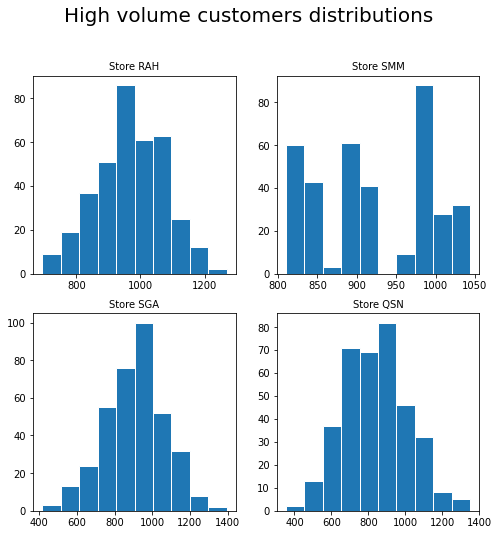

In [ ]:
selected = ['RAH', 'SMM', 'SGA', 'QSN']
fig = plt.figure(figsize=(8, 8))
fig.suptitle('High volume customers distributions', fontsize=20, position=(0.5, 1.0))
counter = 1
for name in selected:
    sub = fig.add_subplot(2, 2, counter)
    sub.hist(customers_reorder[name], edgecolor='w')
    sub.set_title('Store ' + name, fontsize=10)
    counter += 1


The high volume stores are mainly normal distributions except Store SMM.

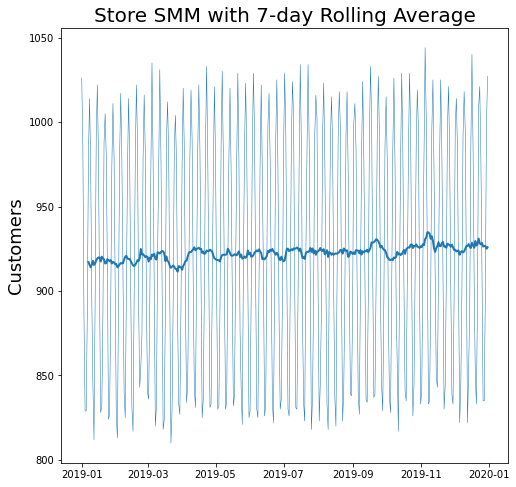

In [ ]:
period = 7
rolling_average = customers_selected1['SMM'].rolling(window=period).mean()

plt.figure(figsize=(8, 8))
plt.plot(customers_selected1['SMM'], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average, linewidth=2)
plt.ylabel('Customers', fontsize=18)
plt.title('Store SMM with 7-day Rolling Average', fontsize=20)
plt.show()

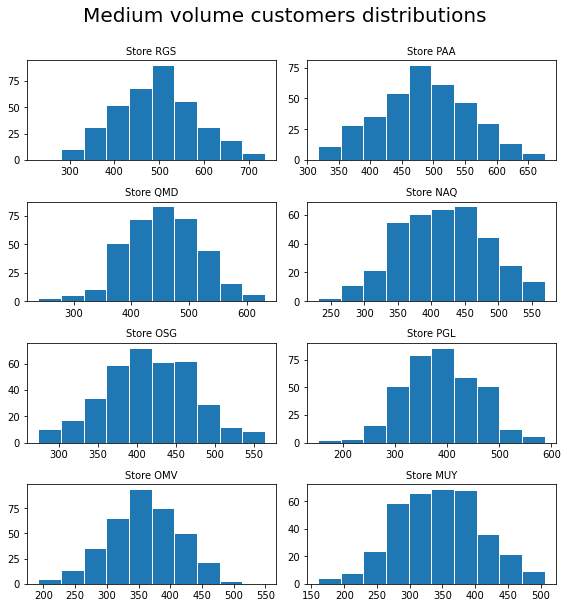

In [ ]:
selected = ['RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY']
fig = plt.figure(figsize=(8, 8))
fig.suptitle('Medium volume customers distributions', fontsize=20, position=(0.5, 1.05))
counter = 1
for name in selected:
    sub = fig.add_subplot(4, 2, counter)
    sub.hist(customers_reorder[name], edgecolor='w')
    sub.set_title('Store ' + name, fontsize=10)
    counter += 1
plt.tight_layout()


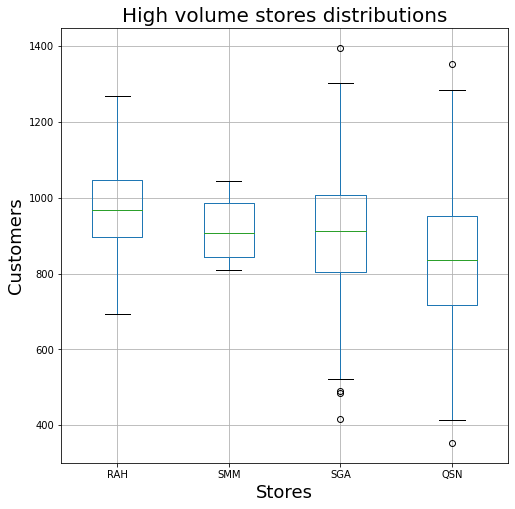

In [ ]:
selected = ['RAH', 'SMM', 'SGA', 'QSN']

plt.figure(figsize=(8, 8))
customers_reorder[selected].boxplot()
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('High volume stores distributions', fontsize=20)
plt.show()

Store SMM has a narrow spread, Stores SGA and QSN are the noisiest high volume stores and Stores SGA and QSN  also have outliers on the lower and upper regions. 

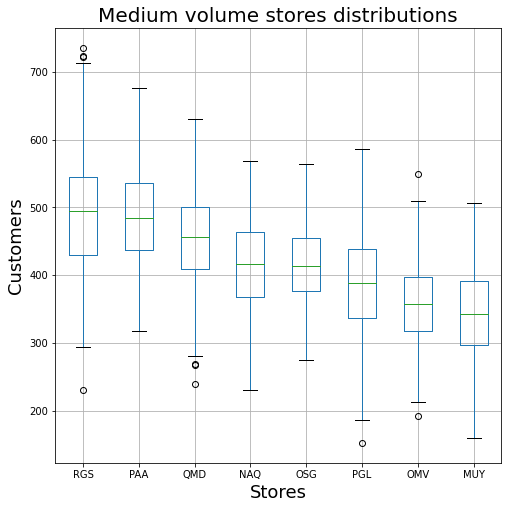

In [ ]:
selected = ['RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY']
plt.figure(figsize=(8, 8))
customers_reorder[selected].boxplot()
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Medium volume stores distributions', fontsize=20)
plt.show()

Stores NAQ, OSG,MUY and PAA have no outliers, while the rest have outliers either at the upper or lower regions. 

QSG has the smallest spread of all the medium volume stores, while the other stores have a wider spread. 

MUY  has the lowest median of the pack at around 350 customers while RSG has the highest median at approximately 500 customers. 



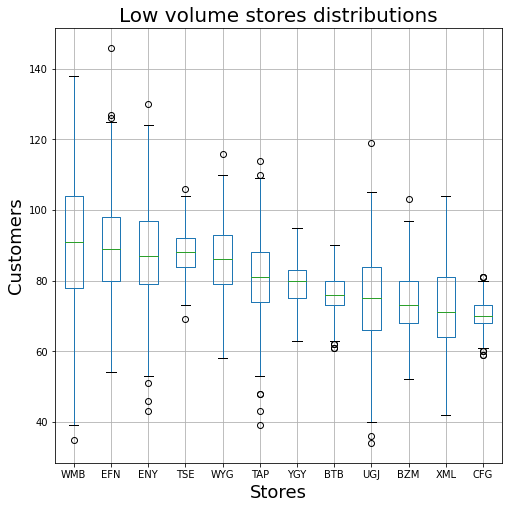

In [ ]:
selected = ['WMB', 'EFN', 'ENY', 'TSE', 'WYG', 'TAP', 'YGY', 'BTB', 'UGJ', 'BZM','XML', 'CFG']
plt.figure(figsize=(8, 8))
customers_reorder[selected].boxplot()
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Low volume stores distributions', fontsize=20)
plt.show()

Except for YGY and XML all the other low volume stores have outliers at either their lower or upper regions. 

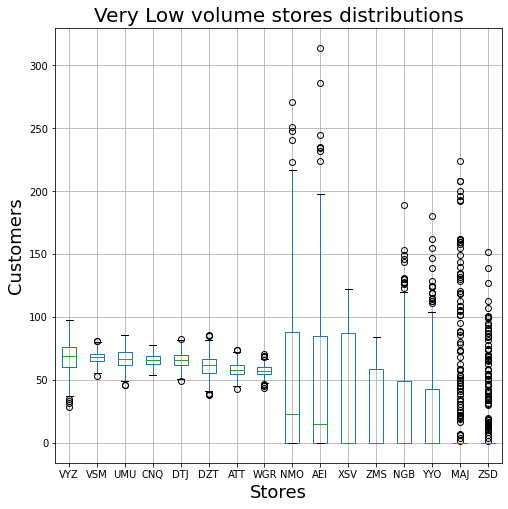

In [ ]:
selected= ['VYZ', 'VSM', 'UMU', 'CNQ', 'DTJ', 'DZT', 'ATT', 'WGR', 'NMO', 'AEI','XSV', 'ZMS', 'NGB', 'YYO', 'MAJ', 'ZSD']
plt.figure(figsize=(8, 8))
customers_reorder[selected].boxplot()
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Very Low volume stores distributions', fontsize=20)
plt.show()

The very low stores has alot of interesting stores. 
Stores XSV, ZMS,NGB and YYO have their median value at 0 (Atleast half their values are zero). While Stores MAJ and ZSD basically have only outliers and would require further investigation. 

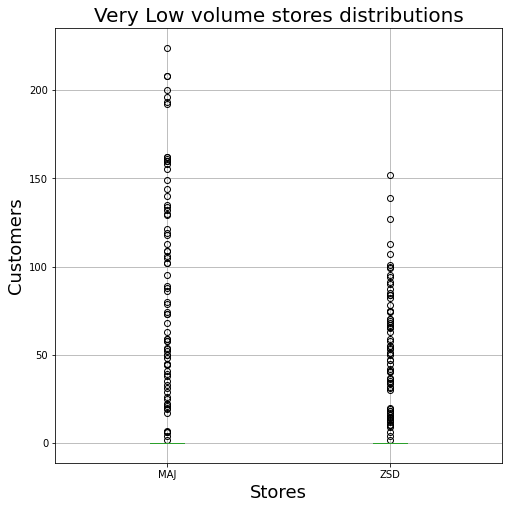

In [ ]:
selected= [ 'MAJ', 'ZSD']
plt.figure(figsize=(8, 8))
customers_reorder[selected].boxplot()
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.title('Very Low volume stores distributions', fontsize=20)
plt.show()

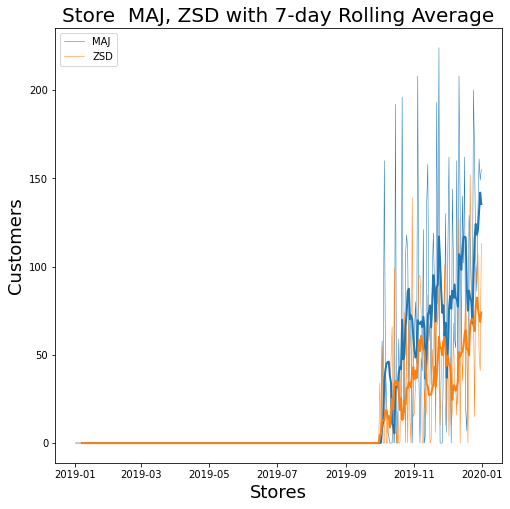

In [ ]:
selected= [ 'MAJ', 'ZSD']
period = 7
rolling_average = customers[selected].rolling(window=period).mean()

plt.figure(figsize=(8, 8))
plt.plot(customers[selected], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average, linewidth=2)
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Customers', fontsize=18)
plt.legend(selected, loc= 2)
plt.title('Store  MAJ, ZSD with 7-day Rolling Average', fontsize=20)
plt.show()

In [ ]:
customers[selected].mean()

MAJ    18.871233
ZSD    10.912329
dtype: float64

Stores MAJ and ZSD opened in the final Quarter of the year.

#Seasonal Variation

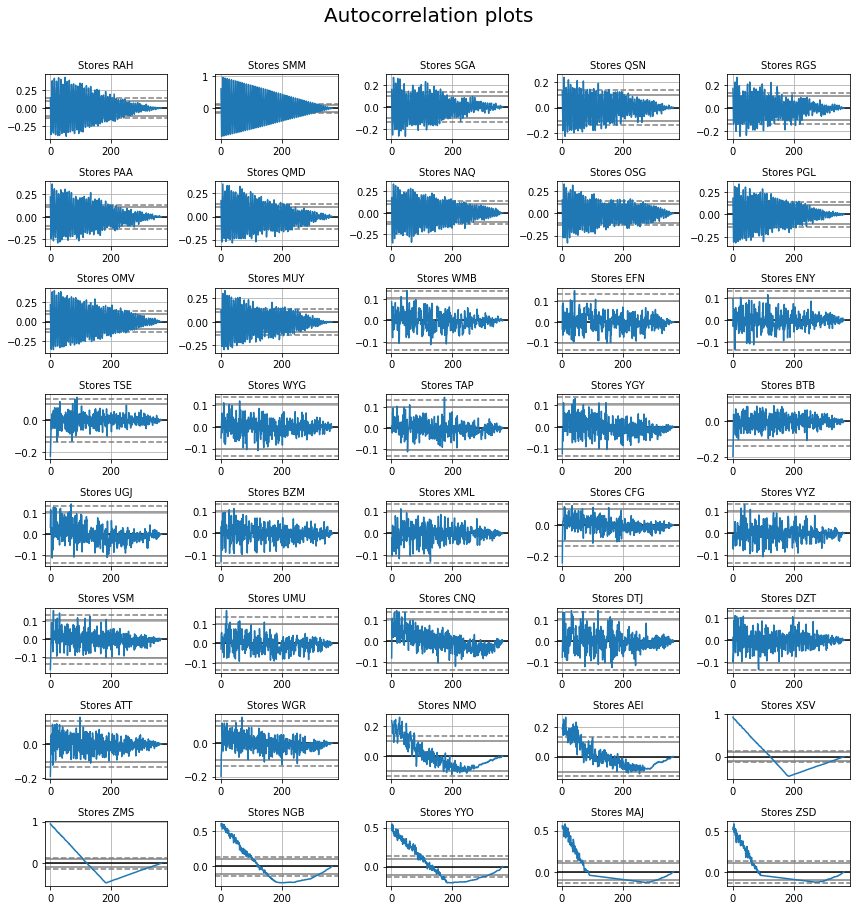

In [ ]:
row = 0
col = 0
fig, axes = plt.subplots(figsize=(12, 12), nrows=8, ncols=5 )
fig.suptitle('Autocorrelation plots', fontsize=20, position=(0.5, 1.05))
for name in customers_reorder.columns:
    sub = pd.plotting.autocorrelation_plot(customers_reorder[name], axes[row, col])
    sub.set_title('Stores ' + name, fontsize=10)
    sub.xaxis.label.set_visible(False)
    sub.yaxis.label.set_visible(False)
    col += 1
    if col == 5:
        row += 1
        col = 0
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()


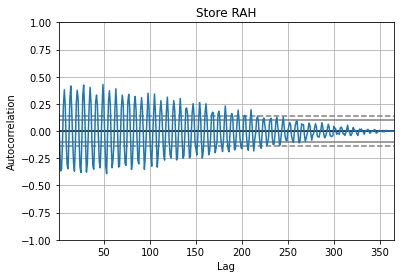

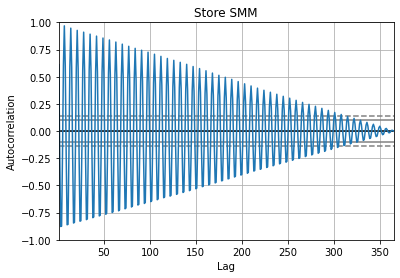

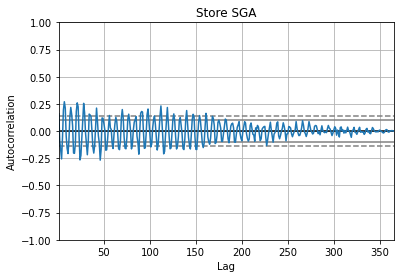

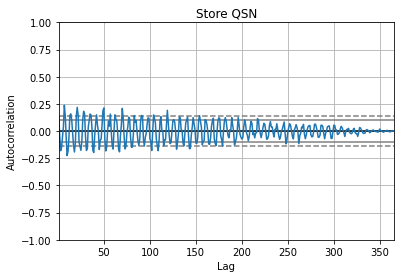

In [ ]:
#Investigating seasonal variations for high volume stores
selected = ['RAH', 'SMM', 'SGA', 'QSN']

for name in selected:
    pd.plotting.autocorrelation_plot(customers_reorder[name])
    # plt.xlim([0, 50]) # uncomment this line to zoom in
    plt.title('Store ' + name)
    plt.show()


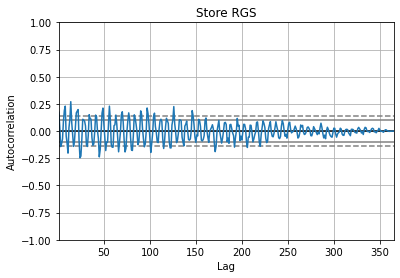

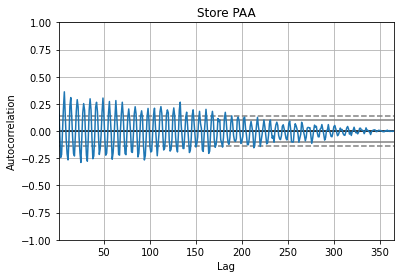

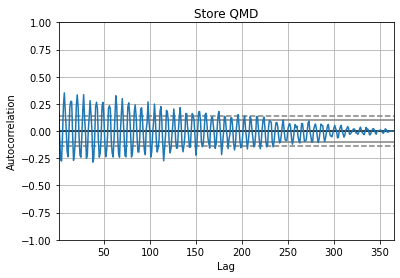

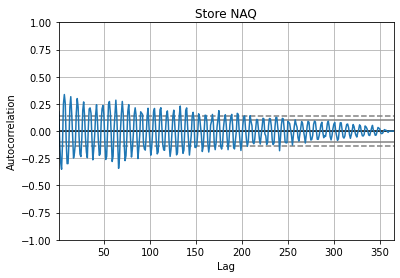

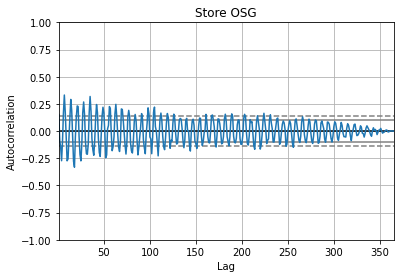

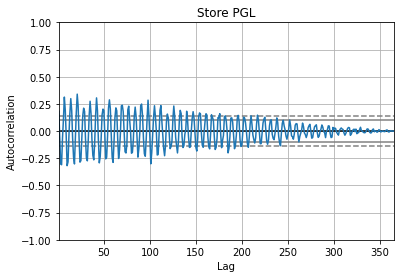

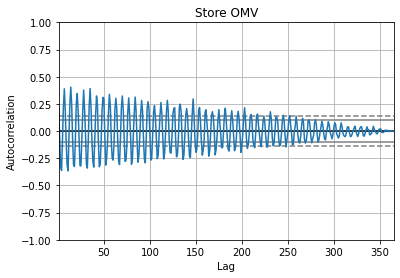

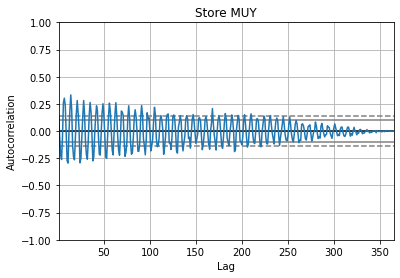

In [ ]:
selected = ['RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY']

for name in selected:
    pd.plotting.autocorrelation_plot(customers_reorder[name])
    # plt.xlim([0, 50]) # uncomment this line to zoom in
    plt.title('Store ' + name)
    plt.show()

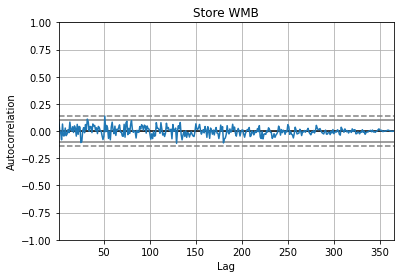

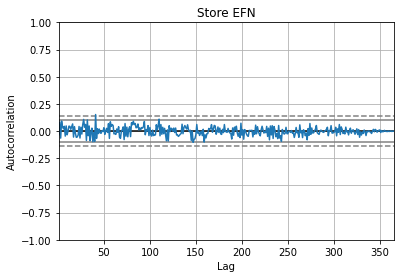

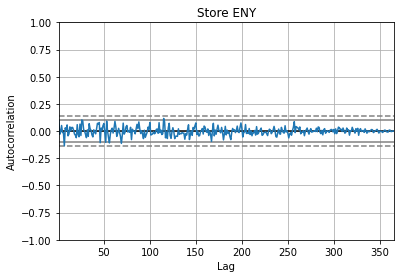

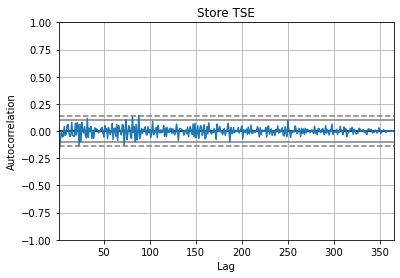

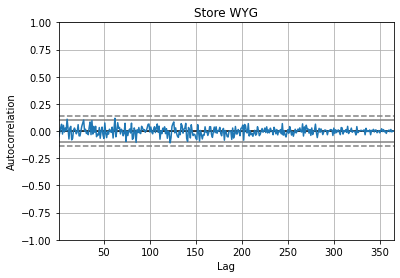

...

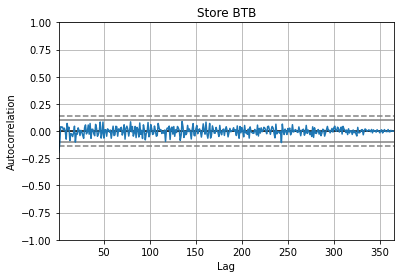

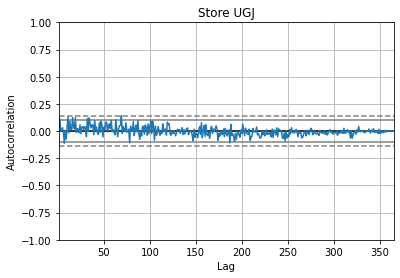

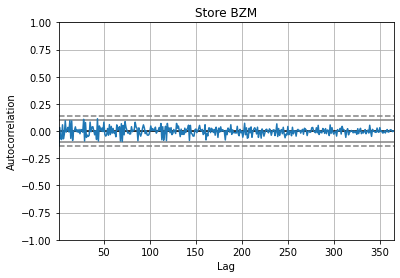

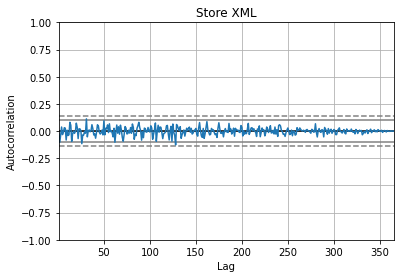

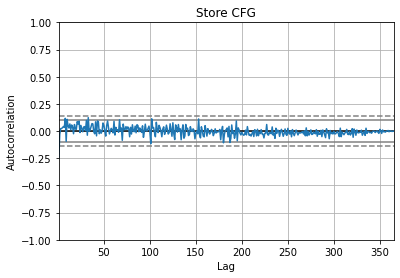

In [ ]:
selected = ['WMB', 'EFN', 'ENY', 'TSE', 'WYG', 'TAP', 'YGY', 'BTB', 'UGJ', 'BZM','XML', 'CFG']

for name in selected:
    pd.plotting.autocorrelation_plot(customers_reorder[name])
    plt.title('Store ' + name)
    plt.show()

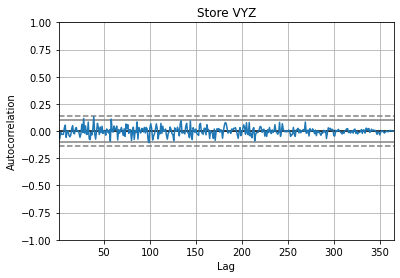

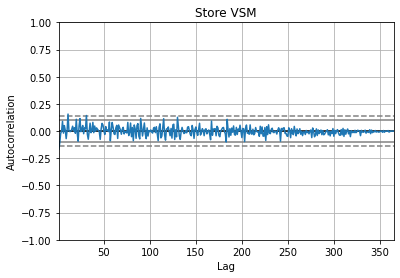

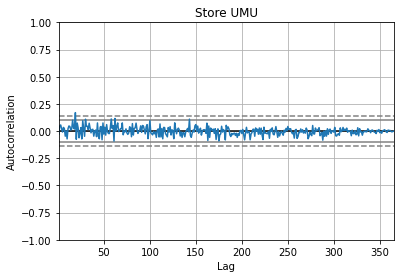

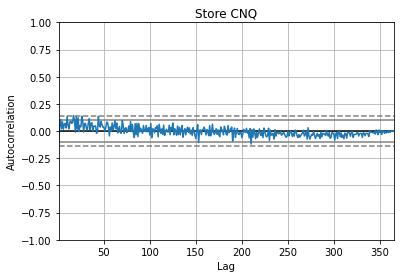

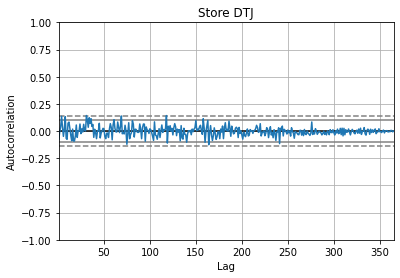

...

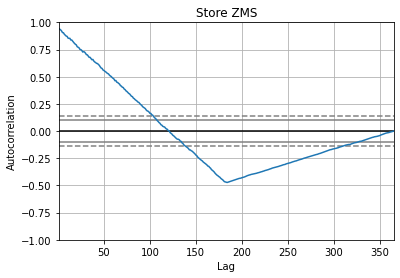

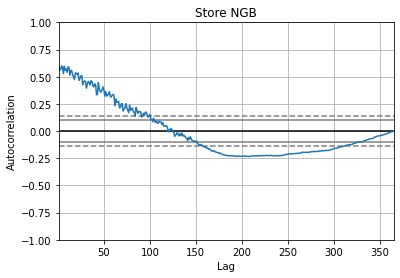

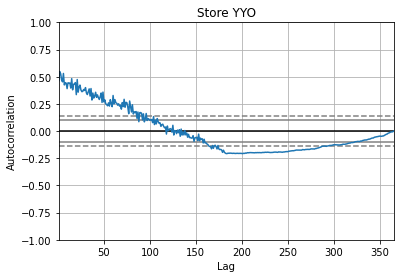

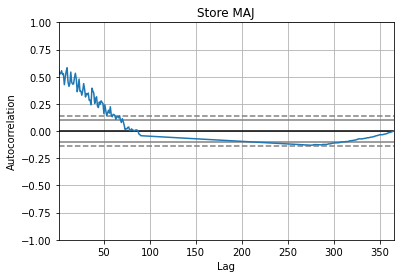

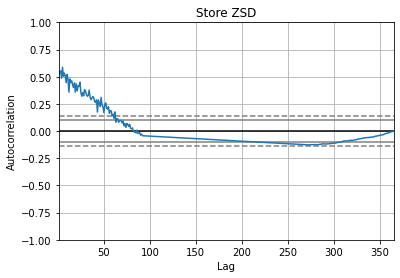

In [ ]:
selected= ['VYZ', 'VSM', 'UMU', 'CNQ', 'DTJ', 'DZT', 'ATT', 'WGR', 'NMO', 'AEI','XSV', 'ZMS', 'NGB', 'YYO', 'MAJ', 'ZSD']
for name in selected:
    pd.plotting.autocorrelation_plot(customers_reorder[name])
    # plt.xlim([0, 50]) # uncomment this line to zoom in
    plt.title('Store ' + name)
    plt.show()

In [ ]:
selected =['RAH', 'SMM', 'SGA', 'QSN','RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY']
customer_hm = customers[selected]

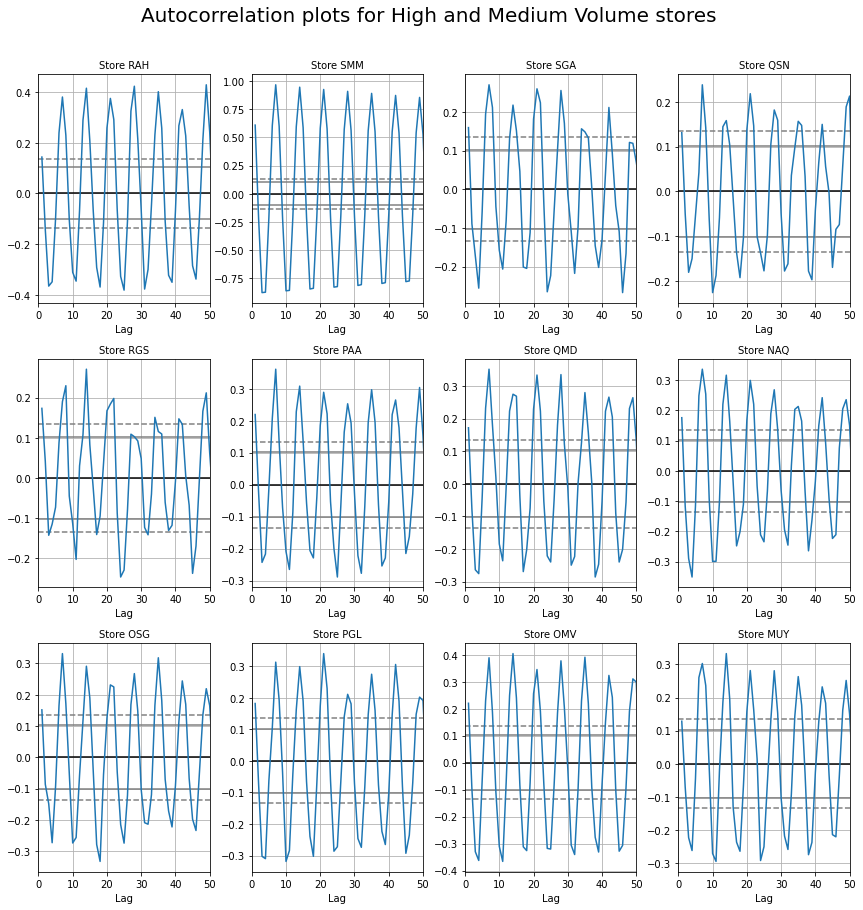

In [ ]:
row = 0
col = 0
fig, axes = plt.subplots(figsize=(12, 12), nrows=3, ncols=4 )
fig.suptitle('Autocorrelation plots for High and Medium Volume stores', fontsize=20, position=(0.5, 1.05))
for name in customer_hm.columns:
    sub = pd.plotting.autocorrelation_plot(customer_hm[name], axes[row, col])
    sub.set_title('Store ' + name, fontsize=10)
    sub.set_xlim(xmin=0,xmax=50) 
    sub.yaxis.label.set_visible(False)
    col += 1
    if col == 4:
        row += 1
        col = 0
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.xlim([0,50])
plt.tight_layout()
plt.show()

The secondary peak here is at 7 days, displaying **weekly seasonality** for the high and medium volume stores.

(Peaks at 7,14,21,28,..... days)

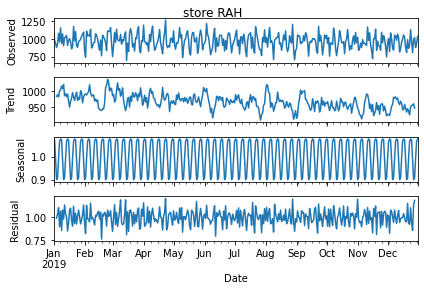

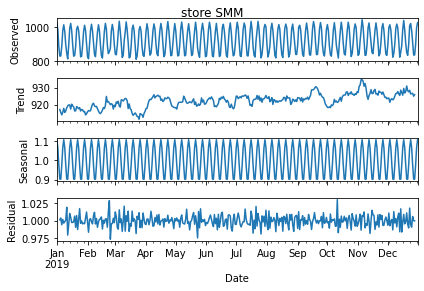

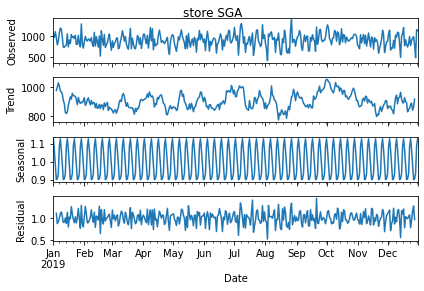

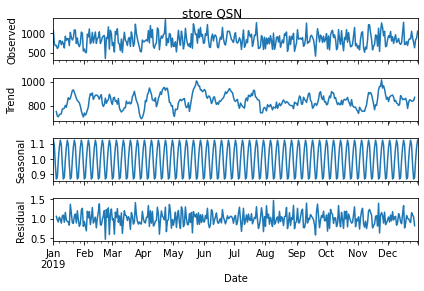

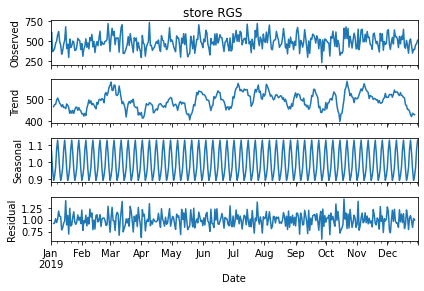

...

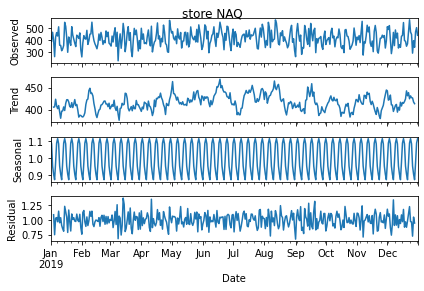

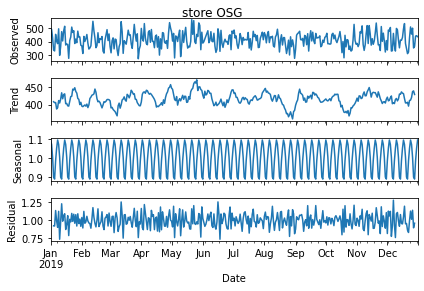

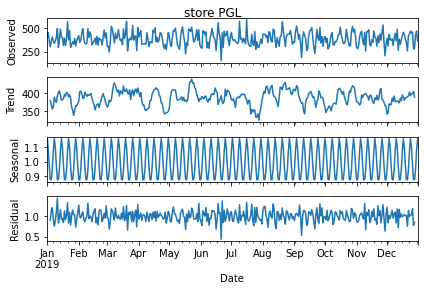

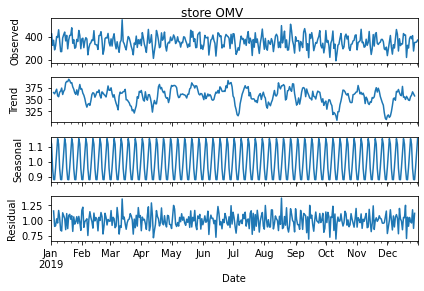

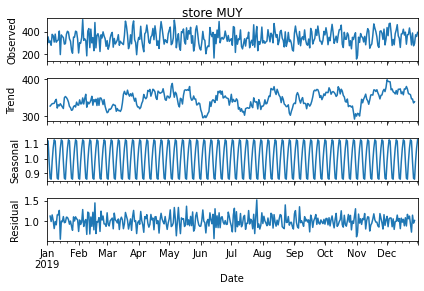

In [ ]:
for name in customer_hm:
    result = seasonal_decompose(customer_hm[name], model='multiplicative', freq=7)
    result.plot()
    plt.suptitle('store ' + name, position=(0.5, 1.0))
    plt.show()


# Summary Data Analysis

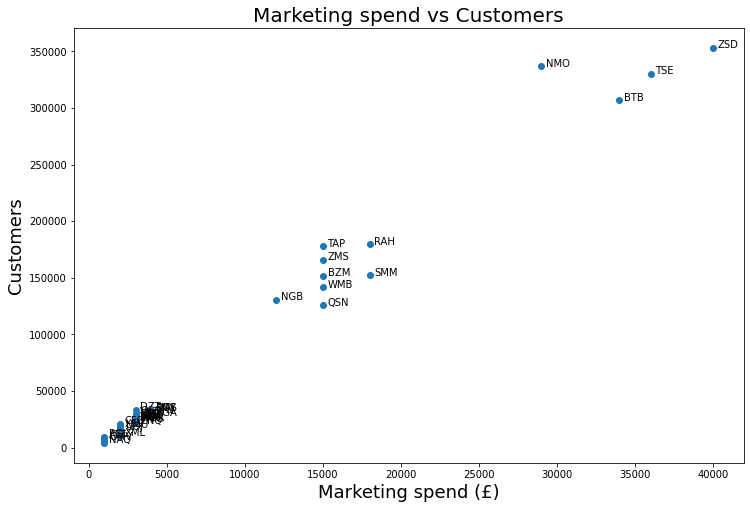

In [ ]:
plt.figure(figsize=(12, 8))
plt.scatter(summary_data['Marketing'], summary_data['Customers'])
plt.title('Marketing spend vs Customers', fontsize=20)
plt.xlabel('Marketing spend (£)', fontsize=18)
plt.ylabel('Customers', fontsize=18)
for i, name in enumerate(customers_reorder.columns):
    plt.annotate(name, (summary_data['Marketing'][i] + 300, summary_data['Customers'][i]))
plt.show()


Wrangling the data to remove the clutter by merging the small and very small stores to make the plot clearer. The stores are merged into 8, this is done to keep them small but visible enough for observation.

In [ ]:
summary_Transpose = summary_data.T

In [ ]:
selected1 = ['WMB', 'EFN', 'WYG' ]
selected2 = ['TSE', 'XSV','TAP','VSM']
selected3 = ['YGY', 'BTB', 'UGJ','XML']
selected4 = ['BZM', 'CFG','ZSD']
selected5 = ['VYZ','ENY', 'UMU']
selected6 = ['CNQ', 'DTJ', 'DZT', 'ATT']
selected7 = ['WGR', 'NMO','YYO']
selected8 = ['ZMS', 'NGB','AEI','MAJ']


In [ ]:
selected = ['WMB', 'EFN', 'ENY', 'TSE', 'WYG', 'TAP', 'YGY', 'BTB', 'UGJ', 'BZM','XML', 'CFG','VYZ', 'VSM', 'UMU', 'CNQ', 'DTJ', 'DZT', 'ATT', 'WGR', 'NMO', 'AEI','XSV', 'ZMS', 'NGB', 'YYO', 'MAJ', 'ZSD']


In [ ]:
summary_drop1 = summary_Transpose[selected1]
summary_drop2 = summary_Transpose[selected2]
summary_drop3 = summary_Transpose[selected3]
summary_drop4 = summary_Transpose[selected4]
summary_drop5 = summary_Transpose[selected5]
summary_drop6 = summary_Transpose[selected6]
summary_drop7 = summary_Transpose[selected7]
summary_drop8 = summary_Transpose[selected8]


In [ ]:
sum_Trans1 = summary_drop1.T.sum()
sum_Trans2 = summary_drop2.T.sum()
sum_Trans3 = summary_drop3.T.sum()
sum_Trans4 = summary_drop4.T.sum()
sum_Trans5 = summary_drop5.T.sum()
sum_Trans6 = summary_drop6.T.sum()
sum_Trans7 = summary_drop7.T.sum()
sum_Trans8 = summary_drop8.T.sum()


In [ ]:
summary_Transpose2 = summary_Transpose.drop(selected, axis=1)

In [ ]:
print(sum_Trans1)
print(sum_Trans2)
print(sum_Trans3)
print(sum_Trans4)
print(sum_Trans5)
print(sum_Trans6)
print(sum_Trans7)
print(sum_Trans8)

Customers      97069
Store_size      1578
Staff             11
Marketing      11000
Overhead      186000
dtype: int64
Customers     102043
Store_size       996
Staff              9
Marketing      12000
Overhead      229000
dtype: int64
Customers     110165
Store_size      1937
Staff             16
Marketing      13000
Overhead      212000
dtype: int64
Customers      56560
Store_size       790
Staff              7
Marketing       7000
Overhead      142000
dtype: int64
Customers      81548
Store_size      1273
Staff             10
Marketing      10000
Overhead      126000
dtype: int64
Customers      91956
Store_size      1075
Staff             10
Marketing      12000
Overhead      159000
dtype: int64
Customers      48070
Store_size       701
Staff              8
Marketing       5000
Overhead      190000
dtype: int64
Customers      44336
Store_size       372
Staff              4
Marketing       6000
Overhead      310000
dtype: int64


In [ ]:
summary_Transpose2['OT1'] = sum_Trans1
summary_Transpose2['OT2'] = sum_Trans2
summary_Transpose2['OT3'] = sum_Trans3
summary_Transpose2['OT4'] = sum_Trans4
summary_Transpose2['OT5'] = sum_Trans5
summary_Transpose2['OT6'] = sum_Trans6
summary_Transpose2['OT7'] = sum_Trans7
summary_Transpose2['OT8'] = sum_Trans8


In [ ]:
new_summary = summary_Transpose2.T

In [ ]:
new_summary

,Customers,Store_size,Staff,Marketing,Overhead
RGS,179589,1851,9,18000,52000
NAQ,152253,1426,6,18000,19000
MUY,125653,2252,17,15000,82000
PGL,141518,887,6,15000,15000
SGA,330402,6579,61,36000,97000
PAA,177802,2047,13,15000,54000
QSN,306734,5946,35,34000,89000
OSG,151802,2526,20,15000,56000
SMM,336765,7441,46,29000,26000
QMD,165896,2506,11,15000,61000


In [ ]:
#Verifying out new summary data has the same sum value as the summary data wrangled.
print(summary_data.sum())
print(new_summary.sum())

Customers     3183985
Store_size      51794
Staff             372
Marketing      338000
Overhead      2134000
dtype: int64
Customers     3183985
Store_size      51794
Staff             372
Marketing      338000
Overhead      2134000
dtype: int64


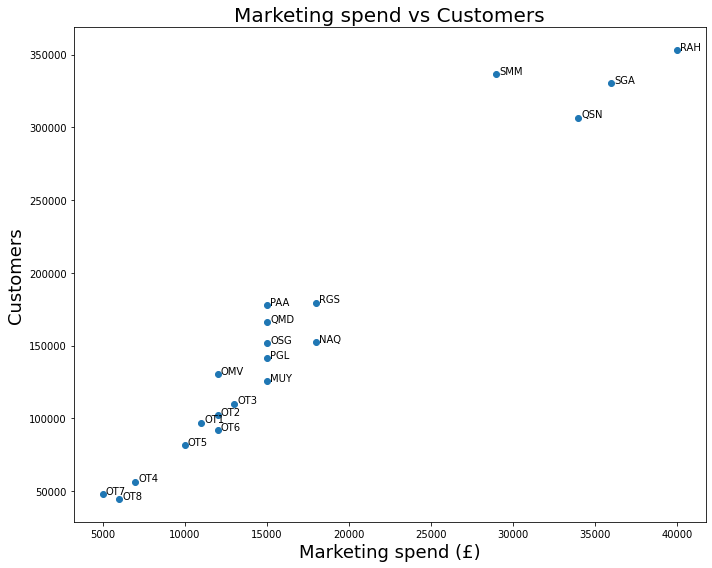

In [ ]:
plt.figure(figsize=(10,8))
plt.scatter(new_summary['Marketing'], new_summary['Customers'])
plt.title('Marketing spend vs Customers', fontsize=20)
plt.xlabel('Marketing spend (£)', fontsize=18)
plt.ylabel('Customers', fontsize=18)
for i, name in enumerate(summary_Transpose2.columns):
    plt.annotate(name, (new_summary['Marketing'][i] + 200, new_summary['Customers'][i]))
plt.tight_layout()
plt.show()

In [ ]:
selected = ['PAA', 'QMD', 'OSG', 'PGL', 'MUY']
new_summary.T[selected]

,PAA,QMD,OSG,PGL,MUY
Customers,177802,165896,151802,141518,125653
Store_size,2047,2506,2526,887,2252
Staff,13,11,20,6,17
Marketing,15000,15000,15000,15000,15000
Overhead,54000,61000,56000,15000,82000


At a marketing expense of £15,000 PAA recorded the highest number of customers and MUY recorded the lowest

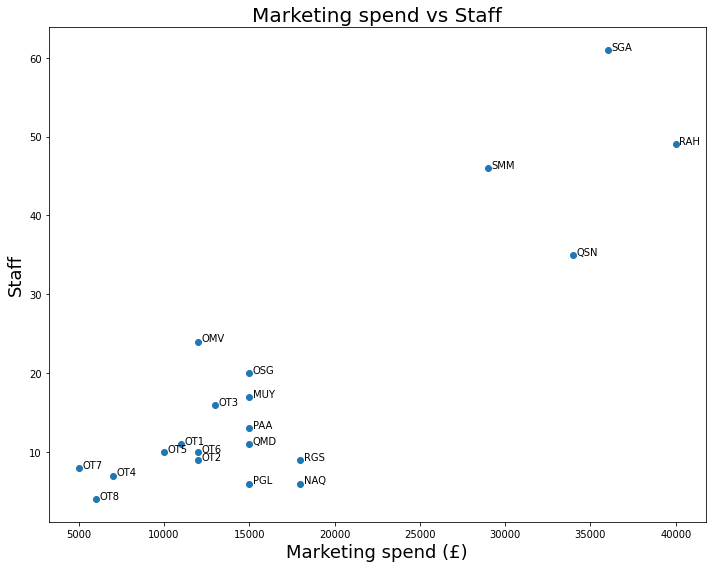

In [ ]:
plt.figure(figsize=(10,8))
plt.scatter(new_summary['Marketing'], new_summary['Staff'])
plt.title('Marketing spend vs Staff', fontsize=20)
plt.xlabel('Marketing spend (£)', fontsize=18)
plt.ylabel('Staff', fontsize=18)
for i, name in enumerate(summary_Transpose2.columns):
    plt.annotate(name, (new_summary['Marketing'][i] + 200, new_summary['Staff'][i]))
plt.tight_layout()
plt.show()

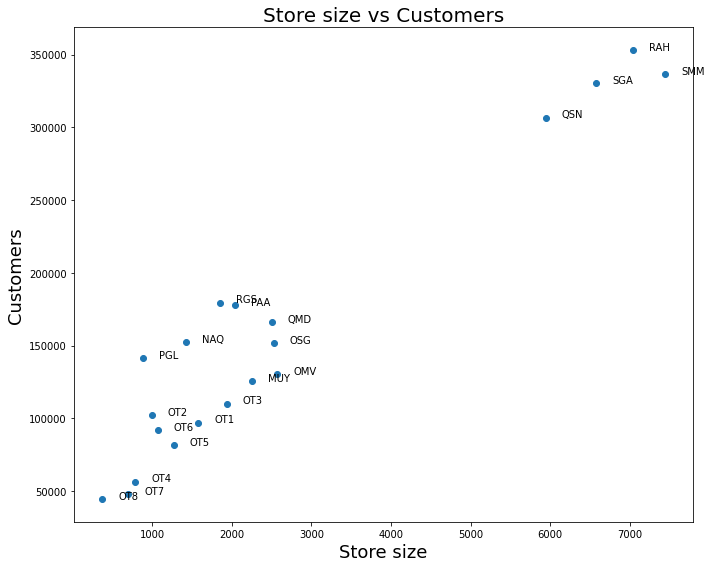

In [ ]:
plt.figure(figsize=(10,8))
plt.scatter(new_summary['Store_size'], new_summary['Customers'])
plt.title('Store size vs Customers', fontsize=20)
plt.xlabel('Store size', fontsize=18)
plt.ylabel('Customers', fontsize=18)
for i, name in enumerate(summary_Transpose2.columns):
    plt.annotate(name, (new_summary['Store_size'][i] + 200, new_summary['Customers'][i]))
plt.tight_layout()
plt.show()

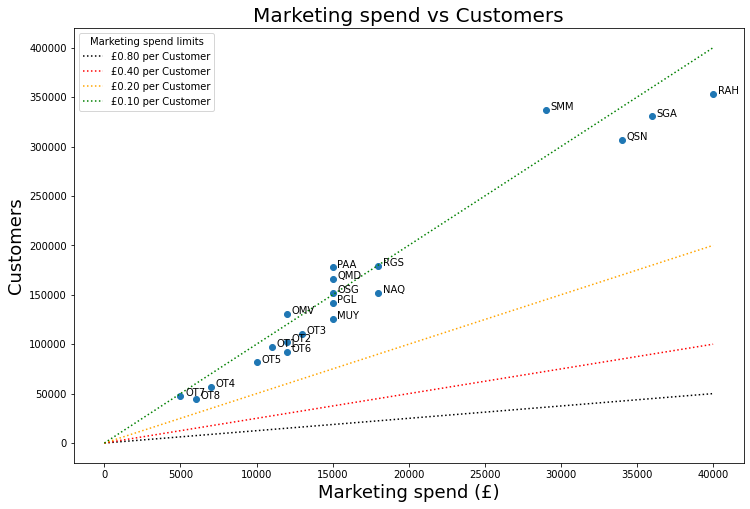

In [ ]:
plt.figure(figsize=(12, 8))
plt.scatter(new_summary['Marketing'], new_summary['Customers'])
plt.title('Marketing spend vs Customers', fontsize=20)
plt.xlabel('Marketing spend (£)', fontsize=18)
plt.ylabel('Customers', fontsize=18)
for i, name in enumerate(summary_Transpose2.columns):
    plt.annotate(name, (new_summary['Marketing'][i] + 300, new_summary['Customers'][i]))
plt.plot([0, 40000], [0, 50000], linestyle=':', color='black', label='£0.80 per Customer')
plt.plot([0, 40000], [0, 100000], linestyle=':', color='red', label='£0.40 per Customer')
plt.plot([0, 40000], [0, 200000], linestyle=':', color='orange', label='£0.20 per Customer')
plt.plot([0, 40000], [0, 400000], linestyle=':', color='green', label='£0.10 per Customer')
plt.legend(loc=2, title='Marketing spend limits')
plt.show()

In [ ]:
selected = ['PAA', 'QMD', 'OSG', 'PGL', 'MUY']
new_summary.T[selected].T # The selected stores all have an equal amount spent on marketing

,Customers,Store_size,Staff,Marketing,Overhead
PAA,177802,2047,13,15000,54000
QMD,165896,2506,11,15000,61000
OSG,151802,2526,20,15000,56000
PGL,141518,887,6,15000,15000
MUY,125653,2252,17,15000,82000


In [ ]:
new_summary2 = new_summary.T[selected].T

In [ ]:
new_summary3 = new_summary.T[selected]

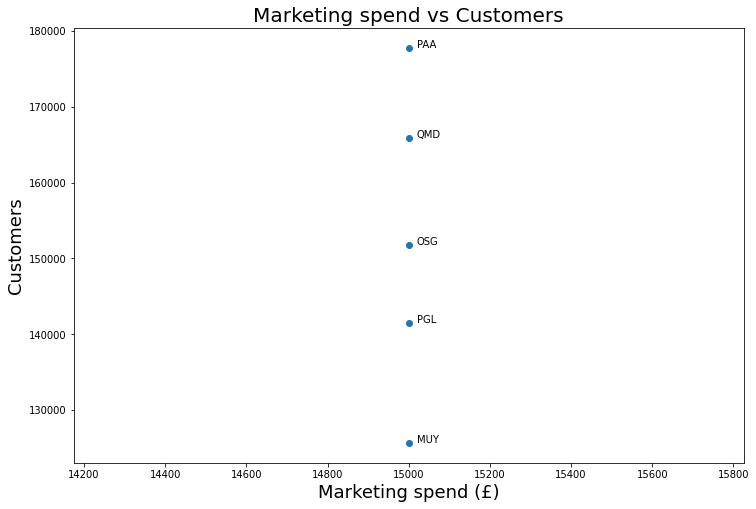

In [ ]:
plt.figure(figsize=(12, 8))
plt.scatter(new_summary2['Marketing'], new_summary2['Customers'])
plt.title('Marketing spend vs Customers', fontsize=20)
plt.xlabel('Marketing spend (£)', fontsize=18)
plt.ylabel('Customers', fontsize=18)
for i, name in enumerate(new_summary3.columns):
    plt.annotate(name, (new_summary2['Marketing'][i] + 20, new_summary2['Customers'][i]))


SMM, PAA, QMD, OMV, OSG and RSG, have very low marketing spend per customer at around £0.10, while the other stores spend around £0.20 per customer. There is a strong correlation between the amount spent on marketing and customers volume for each store.


However, a group of stores(PAA, QMD, OSG, PGL and MUY) spend £15,000 on marketing. However, PAA recorded the highest number of customers, and MUY recorded the lowest number of customers.

#Dimension

     Customers  Store_size     Staff  Marketing  Overhead
RGS   0.508330    0.248757  0.147541      0.450      0.52
NAQ   0.430955    0.191641  0.098361      0.450      0.19
BTB   0.078411    0.056982  0.049180      0.100      0.44
MUY   0.355663    0.302647  0.278689      0.375      0.82
EFN   0.092357    0.028088  0.032787      0.100      0.66


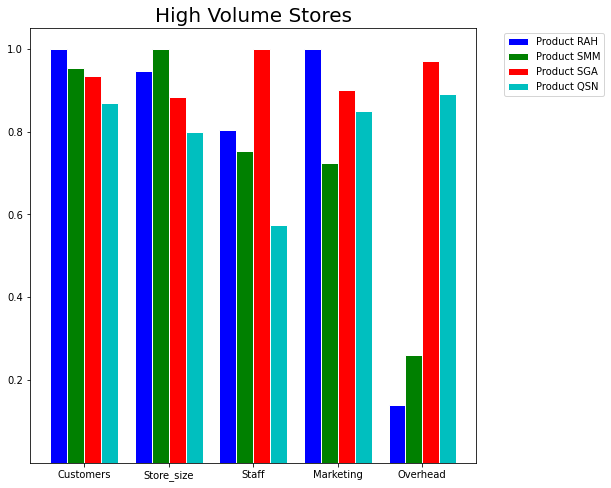

In [ ]:

normalised_data = summary_data / summary_data.max()
print(normalised_data.head())
selected = ['RAH', 'SMM', 'SGA', 'QSN'] # high volume
colours = ['b', 'g', 'r', 'c']
plt.figure(figsize=(8, 8))
c = 0
n_bars = len(selected)
x_pos_base = np.arange(len(summary_data.columns))
bar_width = 0.8 / n_bars
for name in selected:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    x_pos = [x + (bar_width * c) for x in x_pos_base]
    plt.bar(x_pos, values, color=colours[c % len(colours)],
            width=bar_width, edgecolor='white', label='Product ' + name)
    c += 1
plt.yticks([0.2, 0.4, 0.6, 0.8, 1.0])
x_pos = [x + (bar_width * (c - 1) / 2) for x in x_pos_base]
plt.xticks(x_pos, summary_data.columns)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.title('High Volume Stores', fontsize = 20)
plt.show()


RAH has the highest number of customers and spends the most on marketing, while it has the lowest overhead recorded by any of the high volume stores. 
SMM has the biggest store size and the lowest marketing cost of all the high volume stores. 

     Customers  Store_size     Staff  Marketing  Overhead
RGS   0.508330    0.248757  0.147541      0.450      0.52
NAQ   0.430955    0.191641  0.098361      0.450      0.19
BTB   0.078411    0.056982  0.049180      0.100      0.44
MUY   0.355663    0.302647  0.278689      0.375      0.82
EFN   0.092357    0.028088  0.032787      0.100      0.66


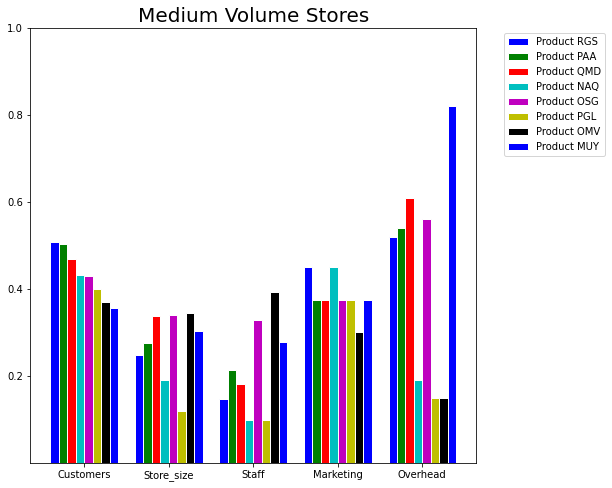

In [ ]:

normalised_data = summary_data / summary_data.max()
print(normalised_data.head())

selected = ['RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY']# medium volume
colours = ['b', 'g', 'r', 'c', 'm', 'y', 'k']
plt.figure(figsize=(8, 8))
c = 0
n_bars = len(selected)
x_pos_base = np.arange(len(summary_data.columns))
bar_width = 0.8 / n_bars
for name in selected:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    x_pos = [x + (bar_width * c) for x in x_pos_base]
    plt.bar(x_pos, values, color=colours[c % len(colours)],
            width=bar_width, edgecolor='white', label='Product ' + name)
    c += 1
plt.yticks([0.2, 0.4, 0.6, 0.8, 1.0])
x_pos = [x + (bar_width * (c - 1) / 2) for x in x_pos_base]
plt.xticks(x_pos, summary_data.columns)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.title('Medium Volume Stores', fontsize = 20)
plt.show()


From the plot above, its clear MUY has a distinctively high overhead in comparison to the other medium volume stores. However it has the lowest volume of customers amongst these group of stores. 

RGS has the largest volume of customers, its volume is marginally higher than PAA but RGS has a much large amount spent on marketing in comparison to the PAA. 

NAA equally tops the list for the highest marketing budget for medium volume stores, however its costumer volume is much lower than RSG, although NAA has a smaller store size, staff strength and overhead with respect to RSG. 

OMV has the largest store size, the highest staff strength, however it has the lowest marketing budget, lowest overhead and the second smallest volume of customers amongst the medium volume stores. 

PGL has the smallest store size, smallest staff strength, smallest overhead with an average marketing budget, however it records the third smallest volume of customers.

     Customers  Store_size     Staff  Marketing  Overhead
RGS   0.508330    0.248757  0.147541      0.450      0.52
NAQ   0.430955    0.191641  0.098361      0.450      0.19
BTB   0.078411    0.056982  0.049180      0.100      0.44
MUY   0.355663    0.302647  0.278689      0.375      0.82
EFN   0.092357    0.028088  0.032787      0.100      0.66


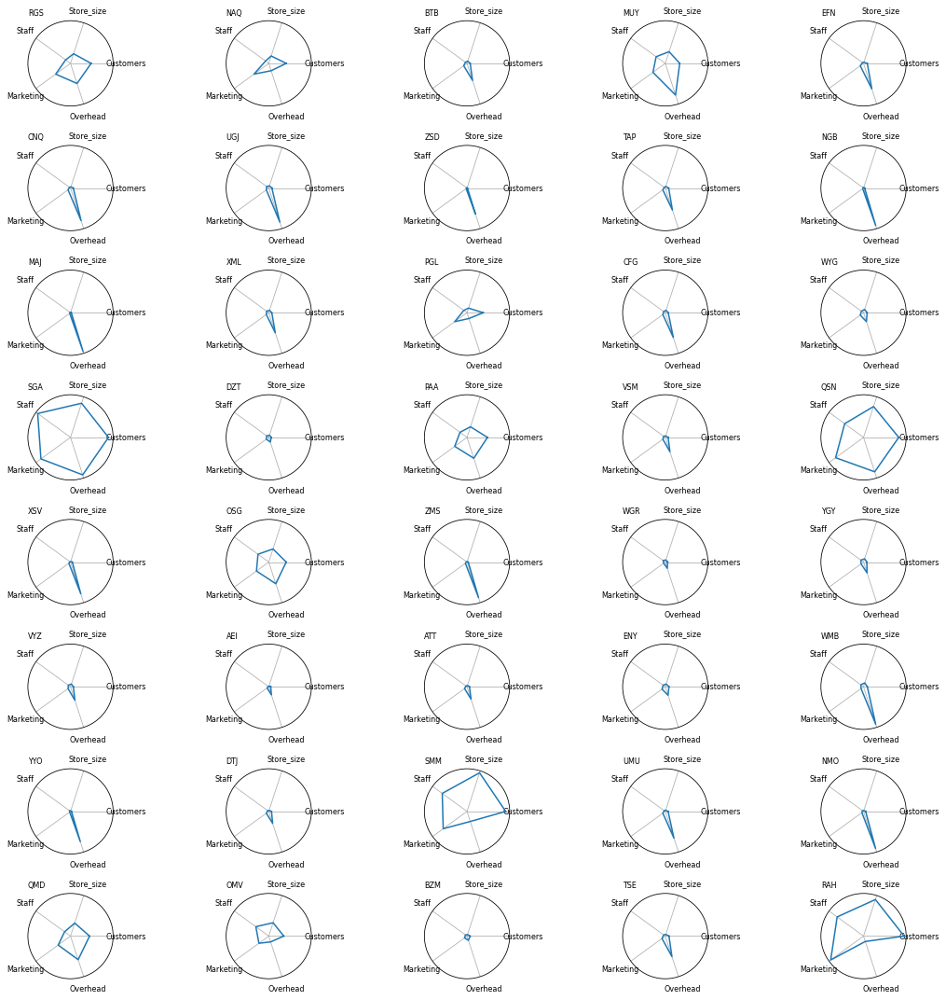

In [ ]:
normalised_data = summary_data / summary_data.max()
print(normalised_data.head())

n_attributes = len(summary_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
plt.figure(figsize=(15, 15))
counter = 1
for name in normalised_data.index:
    # values = normalised_data.transpose()[name].values.flatten().tolist()
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub = plt.subplot(8, 5, counter, polar=True)
    sub.plot(angles, values)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns, fontsize=8)
    sub.set_title(name, fontsize=8, loc='left')
    counter += 1
plt.tight_layout()
plt.show()


     Customers  Store_size     Staff  Marketing  Overhead
RGS   0.508330    0.248757  0.147541      0.450      0.52
NAQ   0.430955    0.191641  0.098361      0.450      0.19
BTB   0.078411    0.056982  0.049180      0.100      0.44
MUY   0.355663    0.302647  0.278689      0.375      0.82
EFN   0.092357    0.028088  0.032787      0.100      0.66


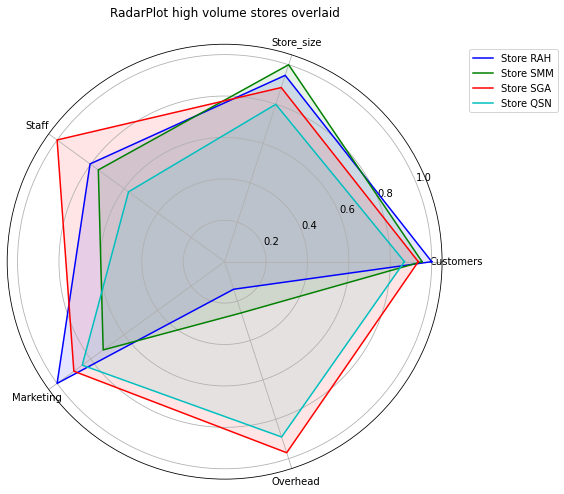

In [ ]:
normalised_data = summary_data / summary_data.max()
print(normalised_data.head())

selected = ['RAH', 'SMM', 'SGA', 'QSN']


n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
colours = ['b', 'g', 'r', 'c']
c = 0
plt.figure(figsize=(8, 8))
sub = plt.subplot(1, 1, 1, polar=True)
for name in selected:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub.plot(angles, values, colours[c % len(colours)], label='Store ' + name)
    sub.fill(angles, values, colours[c % len(colours)], alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns)
    c += 1
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.title('RadarPlot high volume stores overlaid')
plt.show()


RAH has the highest number of customer but it also have a high marketing cost but it also has the lowest overhead.

SMM is the next store in terms of volume of customers, however it has the largest store size. SMM has the lowest marketing cost and the second lowest overhead cost amongst all the high volume stores.

SGA has the highest staff size, the highest overhead and the second highest marketing cost of the high volume stores. 

QSN has the smallest number of customers, the smallest staff size of the high volume stores, however it has the second highest overhead cost of the high volume stores. 


     Customers  Store_size     Staff  Marketing  Overhead
RGS   0.508330    0.248757  0.147541      0.450      0.52
NAQ   0.430955    0.191641  0.098361      0.450      0.19
BTB   0.078411    0.056982  0.049180      0.100      0.44
MUY   0.355663    0.302647  0.278689      0.375      0.82
EFN   0.092357    0.028088  0.032787      0.100      0.66


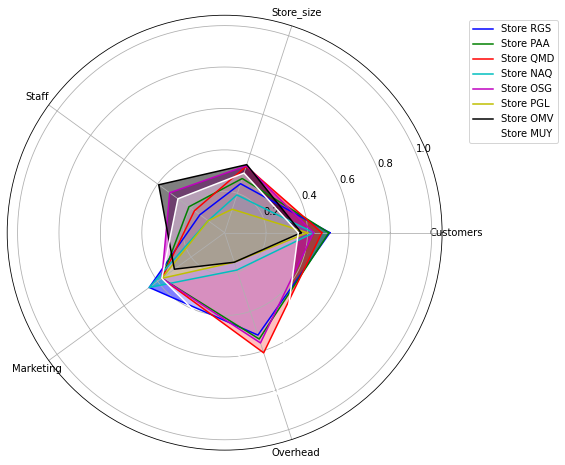

In [ ]:
normalised_data = summary_data / summary_data.max()
print(normalised_data.head())

selected = ['RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY']
n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
colours = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'w']
c = 0
plt.figure(figsize=(8, 8))
sub = plt.subplot(1, 1, 1, polar=True)
for name in selected:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub.plot(angles, values, colours[c % len(colours)], label='Store ' + name)
    sub.fill(angles, values, colours[c % len(colours)], alpha=0.5)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns)
    c += 1
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()

     Customers  Store_size     Staff  Marketing  Overhead
RGS   0.508330    0.248757  0.147541      0.450      0.52
NAQ   0.430955    0.191641  0.098361      0.450      0.19
BTB   0.078411    0.056982  0.049180      0.100      0.44
MUY   0.355663    0.302647  0.278689      0.375      0.82
EFN   0.092357    0.028088  0.032787      0.100      0.66


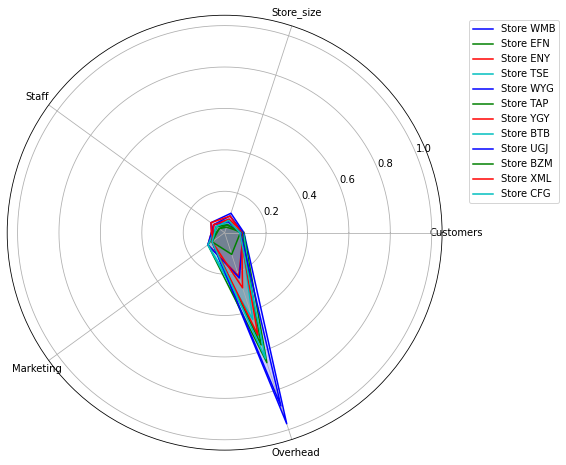

In [ ]:
normalised_data = summary_data / summary_data.max()
print(normalised_data.head())

selected = ['WMB', 'EFN', 'ENY', 'TSE', 'WYG', 'TAP', 'YGY', 'BTB', 'UGJ', 'BZM', 'XML', 'CFG']


n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
colours = ['b', 'g', 'r', 'c']
c = 0
plt.figure(figsize=(8, 8))
sub = plt.subplot(1, 1, 1, polar=True)
for name in selected:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub.plot(angles, values, colours[c % len(colours)], label='Store ' + name)
    sub.fill(angles, values, colours[c % len(colours)], alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns)
    c += 1
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()


The low volume stores register a distinctively high overhead.

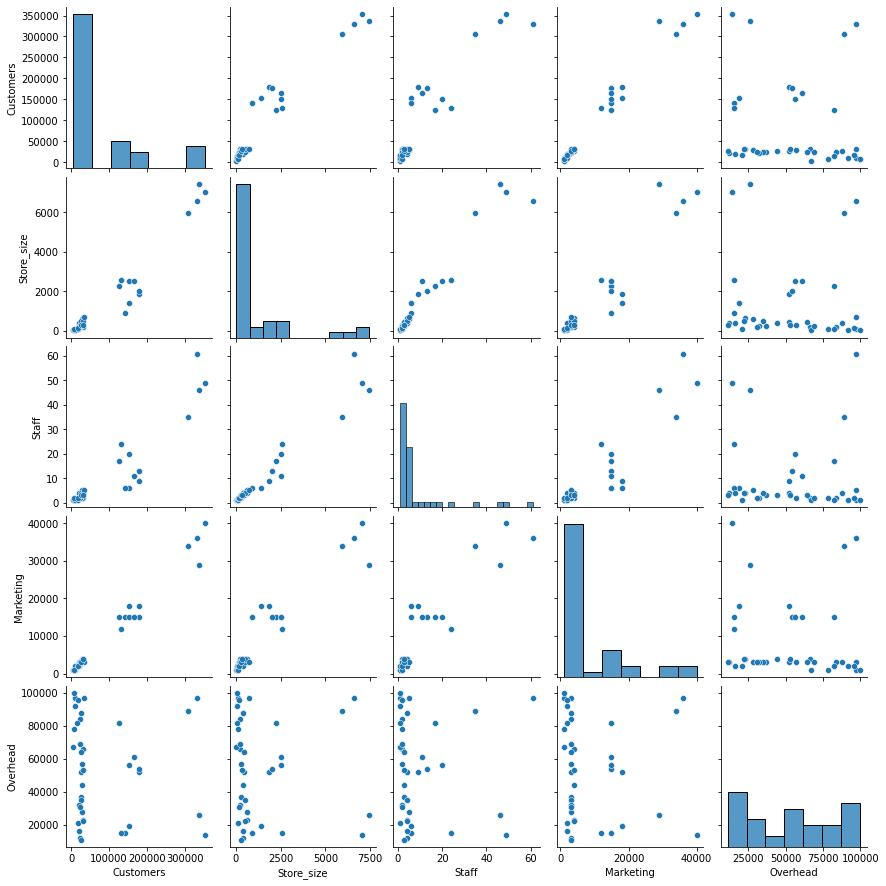

In [ ]:
sns.pairplot(summary_data)
plt.show()


In [ ]:
summary_data2 = summary_data.copy()

In [ ]:
summary_data2.head()

,Customers,Store_size,Staff,Marketing,Overhead
RGS,179589,1851,9,18000,52000
NAQ,152253,1426,6,18000,19000
BTB,27702,424,3,4000,44000
MUY,125653,2252,17,15000,82000
EFN,32629,209,2,4000,66000


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
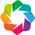

:Overlay
   .Scatter.I                               :Scatter   [Marketing]   (Customers,BubbleSize,index,Store_size,Staff,Overhead)
   .Curve.Pound_0_full_stop_80_per_Customer :Curve   [x]   (y)
   .Curve.Pound_0_full_stop_40_per_Customer :Curve   [x]   (y)
   .Curve.Pound_0_full_stop_20_per_Customer :Curve   [x]   (y)
   .Curve.Pound_0_full_stop_10_per_Customer :Curve   [x]   (y)

In [ ]:
summary_data2['BubbleSize'] = summary_data2['Store_size'] * 0.1

hline200 = hv.Curve([(0, 0), (40000,  50000)], label='£0.80 per Customer').opts(line_dash='dashed', line_width=0.8, color='black')
hline100 = hv.Curve([(0, 0), (40000,  100000)], label='£0.40 per Customer').opts(line_dash='dashed', line_width=0.8, color='red')
hline050 = hv.Curve([(0, 0), (40000,  200000)], label='£0.20 per Customer').opts(line_dash='dashed', line_width=0.8, color='orange')
hline025 = hv.Curve([(0, 0), (40000, 400000)], label='£0.10 per Customer').opts(line_dash='dashed', line_width=0.8, color='green')

plot = summary_data2.hvplot.scatter(
    frame_height=400, frame_width=500,
    title='Marketing vs Customers (vs Store Size)',
    xlabel='Marketing (£)', ylabel='Customers',
    alpha=0.5, padding=0.1, hover_cols='all',
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    x='Marketing', y='Customers', size='BubbleSize'
    
) *\
hline200 *\
hline100 *\
hline050 *\
hline025
hv.extension('bokeh')
plot


In [ ]:
#Reseting the dataframe 
summary_data2 = summary_data.copy()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
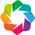

:Overlay
   .Scatter.I                               :Scatter   [Marketing]   (Customers,BubbleSize,index,Store_size,Staff,Overhead)
   .Curve.Pound_0_full_stop_80_per_Customer :Curve   [x]   (y)
   .Curve.Pound_0_full_stop_40_per_Customer :Curve   [x]   (y)
   .Curve.Pound_0_full_stop_20_per_Customer :Curve   [x]   (y)
   .Curve.Pound_0_full_stop_10_per_Customer :Curve   [x]   (y)

In [ ]:
summary_data2['BubbleSize'] = summary_data2['Overhead'] * 0.005

hline200 = hv.Curve([(0, 0), (40000,  50000)], label='£0.80 per Customer').opts(line_dash='dashed', line_width=0.8, color='black')
hline100 = hv.Curve([(0, 0), (40000,  100000)], label='£0.40 per Customer').opts(line_dash='dashed', line_width=0.8, color='red')
hline050 = hv.Curve([(0, 0), (40000,  200000)], label='£0.20 per Customer').opts(line_dash='dashed', line_width=0.8, color='orange')
hline025 = hv.Curve([(0, 0), (40000, 400000)], label='£0.10 per Customer').opts(line_dash='dashed', line_width=0.8, color='green')

plot = summary_data2.hvplot.scatter(
    frame_height=400, frame_width=500,
    title='Marketing vs Customers (vs Overhead)',
    xlabel='Marketing (£)', ylabel='Customers',
    alpha=0.5, padding=0.1, hover_cols='all',
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    x='Marketing', y='Customers', size='BubbleSize'
    
) *\
hline200 *\
hline100 *\
hline050 *\
hline025
hv.extension('bokeh')
plot


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
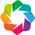

:NdOverlay   [Element]
   :Histogram   [QSN]   (QSN_count)

In [ ]:
selected = ['RAH', 'SMM', 'SGA', 'QSN']

plot = customers_reorder[selected].hvplot.hist(
    frame_height=500, frame_width=500,
    xlabel='Customers per day', ylabel='Frequency',
    title='High Volume Stores',
    alpha=0.5, muted_alpha=0, muted_fill_alpha=0, muted_line_alpha=0,
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset']
)
hv.extension('bokeh')
plot

SMM has a closer distribution and QSN has the widest distribution.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
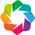

:NdOverlay   [Element]
   :Histogram   [MUY]   (MUY_count)

In [ ]:
selected = ['RGS', 'PAA', 'QMD', 'NAQ', 'OSG', 'PGL', 'OMV', 'MUY']

plot = customers_reorder[selected].hvplot.hist(
    frame_height=500, frame_width=500,
    xlabel='Customers per day', ylabel='Frequency',
    title='Medium Volume Stores',
    alpha=0.5, muted_alpha=0, muted_fill_alpha=0, muted_line_alpha=0,
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset']
)
hv.extension('bokeh')
plot

Interactive distribution of medium volume stores.


**Additional Functionalities** 
The interactive bar plot has additional functionalities. 
 
 -Reset- is used to return the bar chart to its initial state.

-Undo - This click feature is used to undo an action. 

-Redo - This feature is used to redo an action undone using the undo feature. 

-Hover- The bar plot has a hover function for every element in the bar chart, can be used to turn on or off to highlight the chart in the group of plots.

-Elements - The elements are interactive legends that can be clicked to remove a chart from the plot to add visibility by limiting the number of plots.



# **Conclusions**

**General information** 

-The Data Given was clean with no missing values.

-ChrisCo recorded a total of 3183985 customers in 2019.

-Chrisco recorded its lowest total daily customer visit on 23/03/2019, with 7,333 across its stores.

-Chrisco recorded its highest number of customers registered on 17/12/2019 across all its stores, with 10,735 customers.

-There is a slight marginal growth in the number of customers from Q1 to Q4.



**Store segmentation**

-The stores were segmented based on their customer volume in 2019, as shown in the bar plot.

-High Volume Stores - RAH, SMM, SGA and QSN (300,000 customers and above each).

-Medium customer stores - RGS, PAA, QMD, NAQ, OSG, PGL, OMV and MUY (100,000 customers and above each).

-Low customer stores - WMB, EFN, ENY, TSE, WYG, TAP, YGY, BTB, UGJ, BZM,XML,CFG (25,000 customers and above each).

-Very Low customer stores - VYZ, VSM, UMU, CNQ, DTJ, DZT, ATT, WGR, NMO, AEI, XSV, ZMS, NGB, YYO, MAJ and ZSD (25,000 customers or below for each of the stores).




**Correlations**


From the heatmap, we discovered a very strong correlation between marketing, store sizes, staff size, and the volume of customers for ChrisCo stores. The stores with larger marketing budgets, large store sizes and larger staff strength witnessed a larger inflow of customers than other stores.


**Seasonalities**

Using Autocorrelations to investigate the seasonalities, it was discovered that the high and medium volume stores experience weekly seasonalities with consistent peaks and troughs recorded over a 7 day window (7, 14, 21 and on).


**Marketing per Customer**

SMM, PAA, QMD, OMV, OSG and RSG, have very low marketing spend per customer at around £0.10, while the other stores spend around £0.20 per customer.


**High Volume Stores**


From the trendlines, RAH has the highest volume of customers. However, its volume is falling over the year, while the other three stores experience a steady rise in customer volume.

From the radar Plots of the High volume stores, RAH has the highest number of customers, but it also has a high marketing cost, but it also has the lowest overhead.
SMM is the next store in terms of volume of customers. However, it has the largest store size. SMM has the lowest marketing cost and the second-lowest overhead cost amongst all the high volume stores.

SGA has the highest staff size, the highest overhead, and the high volume stores' second-highest marketing cost.
QSN has the smallest number of customers, the smallest staff size of the high volume stores. However, it has the second-highest overhead cost of the high volume stores.
From the boxplot, investigating the high volume stores showed that Store SMM has a narrow spread, Stores SGA and QSN are the noisiest high volume stores and Stores SGA and QSN also have outliers on the lower and upper regions.


**Medium Volume Stores**


From the boxplot of medium volume stores;
Stores NAQ, OSG, MUY and PAA have no outliers, while the rest had outliers either at the upper or lower regions.
QSG has the smallest spread of all the medium volume stores, while the other stores have a wider spread.

MUY has the lowest median of the pack at around 350 customers, while RSG has the highest median at approximately 500 customers.

MUY has a distinctively high overhead from the normalised barplot compared to the other medium volume stores. However, it has the lowest volume of customers amongst these group of stores.

RGS has the largest volume of customers, its volume is marginally higher than PAA but RGS has a much larger amount spent on marketing compared to the PAA.

NAA equally tops the list for the highest marketing budget for medium volume stores. However, its customer volume is much lower than RSG, although NAA has a smaller store size, staff strength and overhead with respect to RSG.

OMV has the largest store size, the highest staff strength. However, it has the lowest marketing budget, lowest overhead and the second smallest volume of customers amongst the medium volume stores.

PGL has the smallest store size, smallest staff strength, smallest overhead with an average marketing budget, however, it records the third smallest volume of customers.

**Stores Opened and Stores Closed During the Year**


After segmenting the very low volume stores;
XSV and ZMS closed in July.

AEI, NGB, NMO, MAJ, YYO and ZSD opened during the year. AEI and NMO opened in April, NGB and YYO opened in July and MAJ, and ZSD opened in October.

**Anomalies**

There was a bit of an anomaly amongst a group of stores(PAA, QMD, OSG, PGL and MUY) that spend £15,000 on marketing. However, PAA recorded the highest number of customers, and MUY recorded the lowest number of customers. Also, the low volume stores incur a high overhead, as seen in the radar plots.



# **References**

Delft Stack (2021) “Python Matplotlib Howto’s.” Delft Stack, https://www.delftstack.com/howto/matplotlib/. Accessed 20 Mar. 2021.

kite(2021) Code Faster with Line-of-Code Completions, Cloudless Processing. https://www.kite.com. Accessed 25 Mar. 2021.

Knaflic, C. (2015) Storytelling with data, John Wiley & Sons, Inc.

Mode (2021) “Creating Chart Annotations Using Matplotlib | Charts - Mode Analytics.” Mode Resources, 13 Mar. 2018, https://mode.com/example-gallery/python_chart_annotations/. Accessed 10 Mar. 2021

Nelli, F. (2017) Python data analytics, Apress.

Stack Overflow (2021) “Python - Boxplot in Pandas: Grouped Boxplot with Aggregate.” Stack Overflow, https://stackoverflow.com/questions/58108259/boxplot-in-pandas-grouped-boxplot-with-aggregate. Accessed 25 Mar. 2021.

Yves, H. (2015) Python for Finance, O’Reilly.


